# <center> <font color='blue'> Segmentation des clients d'un site de e-commerce

### <font color = "blue"> Introduction

<font color = "blue"> Contexte : <br>
    
L'entreprise brésilienne, Olist, propose une solution de commerce sur les marketplaces en ligne. Elle souhaite obtenir une segmentation de ses clients utilisable au quotidien par leur équipe marketing dans leurs campagnes de communication.

<font color = "blue"> Objectif :

- Comprendre les différents types d'utilisateurs grâce à leur comportement et à leurs données personnelles anonymisées ;
- Regrouper ces utilisateurs en fonction de leurs profils ; 

Pour y parvenir, je vais fournir une description actionnable de la segmentation et de sa logique sous-jacente pour une utilisation optimale. Je vais également fournir une analyse de la stabilité des segments au cours du temps (dans le but d'établir un contrat de maintenance).

<font color = "blue"> Méthode :

Pour réaliser ce projet, j'utiliserai les méthodes d'apprentissage non supervisées pour regrouper ensemble des clients de profils similaires. Et le travail sera diviser en 3 parties (notebook) :
- Notebook 1 : réservé à l'exploration des données et la création de variables utiles pour la segmentation des clients" 
- Notebook 2 : réservé à la classification RFM ;
- Notebook 3 : essais des différentes approches de modélisation ;
- Notebook 4 : simulation pour déterminer la fréquence nécessaire de mise à jour du modèle de segmentation.

### <font color = "blue"> Partie I : Exploration des données

#### <font color = "blue"> Procédé :

* Importation des trames de données ;
* Analyse individuelle de chaque trame ;
* Fusion des trames en un dataframe unique ;
* Dernières analyses et nettoyages ;
* Création des variables.

##### <font color = "blue"> Importation des librairies de bases

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import missingno as msn
from skimpy import skim

##### <font color = "blue"> I. Importation des données

Pour cette mission, Olist a fournit une base de données anonymisée comportant des informations sur l’historique des commandes, les produits achetés, les commentaires de satisfaction, et la localisation des clients.

In [2]:
# chargement des 9 trames de données

data_customers = pd.read_csv("olist_customers_dataset.csv") # informations sur les clients
data_localisation = pd.read_csv("olist_geolocation_dataset.csv") # informations sur la géolocalisation

# informations sur les commandes
data_items = pd.read_csv("olist_order_items_dataset.csv") 
data_orders = pd.read_csv("olist_orders_dataset.csv")

# informations sur les produits
data_products = pd.read_csv("olist_products_dataset.csv") 
data_category = pd.read_csv("product_category_name_translation.csv")

data_payment = pd.read_csv("olist_order_payments_dataset.csv") # information de paiement
data_reviews = pd.read_csv("olist_order_reviews_dataset.csv") # Les avis de commande
data_sellers = pd.read_csv("olist_sellers_dataset.csv") # informations sur les marchands

#### <font color = "blue"> II. Exploration des données de chaque dataframe

##### <font color = "blue"> 1. Data_customers

In [3]:
# Visualisation des 5 preières lignes
data_customers.head(5)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [4]:
# Vérification de la présence des valeurs nulles
data_customers.isna().sum().sum()

0

In [5]:
# La trame contient- elle des doublons
print("La trame de données contient", data_customers.duplicated().sum(), "doublon.")

La trame de données contient 0 doublon.


**_observations :_** <br> Cette trame de données ne contient aucune valeur nulle et renseignent les informations :
- D'idendification des clients avec les colonnes "customer_id" et "customer_unique_id" ;
- De géolocalisation des clients ;
- Le nom des états sont des abréviations, pour faciliter leur compréhension je fais les définir. <br>

Les colonnes "customer_id" et "customer_unique_id" contiennent-elles des informations identiques ? <br> Pour repondre à cette question, je vais commencer par afficher la description de la trame de données.

In [6]:
data_customers.describe(include = "all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
customer_id,99441,99441,06b8999e2fba1a1fbc88172c00ba8bc7,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
customer_unique_id,99441,96096,8d50f5eadf50201ccdcedfb9e2ac8455,17,NaN,NaN,NaN,NaN,NaN,NaN,NaN
customer_zip_code_prefix,99441.0,NaN,NaN,NaN,35137.474583,29797.938996,1003.0,11347.0,24416.0,58900.0,99990.0
customer_city,99441,4119,sao paulo,15540,NaN,NaN,NaN,NaN,NaN,NaN,NaN
customer_state,99441,27,SP,41746,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**_Observations :_** <br> 
- La colonne relative au code postal est de type numérique : je vais la transformer en type object ;
- Les deux colonnes ("customer_id" et "customer_unique_id") ne contient pas les mêmes informations, car le nombre de valeurs unique est différente pour ces deux colonnes, pour la trame de données ne contient pas de valeurs nulles. <br> Je vais utiliser le fonction "groupby" pour analyser leur différence en partant de l'hypothèse : une des colonnes est composante  de l'autre.

**_Transformation de la colonne "customer_zip_code_prefix"_**

In [7]:
data_customers["customer_zip_code_prefix"] = data_customers["customer_zip_code_prefix"].astype("str")

In [8]:
# Est-ce qu'un même client (idendifié avec "customer__unique_id") possède plussieurs idendifiants ("customer_id")
identifiant = pd.DataFrame(data_customers.groupby("customer_unique_id")
                           [["customer_id"]].count()["customer_id"]
                          .sort_values(ascending=False))
identifiant[identifiant["customer_id"] > 1].head().reset_index()

,customer_unique_id,customer_id
0,8d50f5eadf50201ccdcedfb9e2ac8455,17
1,3e43e6105506432c953e165fb2acf44c,9
2,6469f99c1f9dfae7733b25662e7f1782,7
3,ca77025e7201e3b30c44b472ff346268,7
4,1b6c7548a2a1f9037c1fd3ddfed95f33,7


On peut en déduire que la colonne "customer_unique_id" est l'identifiant attribué à chaque client et que la colonne "customer_id" correspond à un identifiant généré pour chaque commande et par client. <br>
On peut alors observer le nombre de commande passé par client.

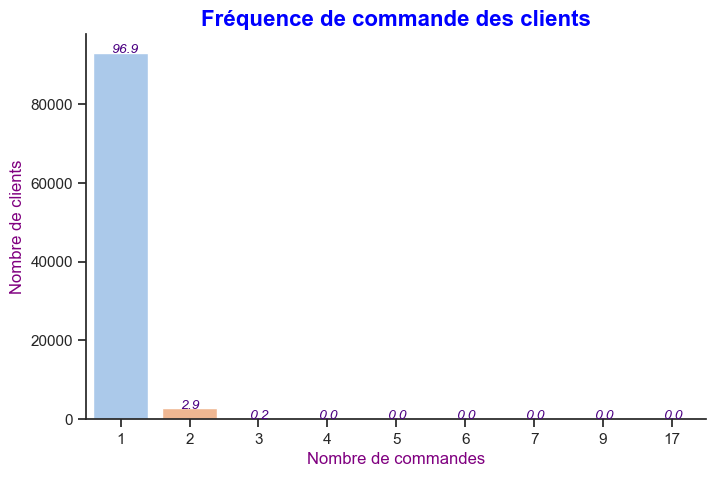

In [9]:
# paramètre du tracé
custom_params = {"axes.spines.right": False, "axes.spines.top": False}
sns.set_theme(style="ticks", rc=custom_params)
font_title = {"family": "serif", "color": "#476bff", "weight": "bold", "size": 16}

# Calcul du nombre de clients uniques
nombre_client = data_customers['customer_unique_id'].nunique()

# Comptage du nombre de commandes par client et décompte des occurrences
commande_par_client = data_customers.groupby('customer_unique_id').size().value_counts()

# Création d'un DataFrame pour la visualisation des commandes par clients
nombre_commande = pd.DataFrame({
    'nombre_commandes': commande_par_client.index,
    'Nombre_clients': commande_par_client.values})

# Calcul du pourcentage de clients par nombre de commandes
nombre_commande['%'] = round((nombre_commande['Nombre_clients'] * 100) / nombre_client, 1)

# Création de la figure et des axes
fig, ax = plt.subplots(figsize=(8, 5))

# Création d'un barplot pour visualiser la distribution
sns.set_style("white")
sns.barplot(x='nombre_commandes', y='Nombre_clients', data=nombre_commande, palette = "pastel")

# Configuration des labels et du titre de l'axe
ax.set_xlabel('Nombre de commandes', fontsize=12, color = "purple")
ax.set_ylabel('Nombre de clients', fontsize=12, color = "purple")
ax.set_title('Fréquence de commande des clients', fontsize = 16, fontweight = "bold", color = "blue")

# Ajout des pourcentages au-dessus de chaque barre du barplot
for i, p in enumerate(ax.patches):
    ax.text(p.get_width() / 3 + p.get_x(), p.get_height() / 1 + p.get_y(), nombre_commande['%'][i],
             fontsize = "small", color ="indigo", fontstyle = "italic")



# Affichage du graphique
plt.show()


**_97% des clients n'ont commandés qu'une seule fois et moins de 3% ont commandé 2 fois_**

**_Transformation de la colonne "customer_state"_** <br>
A fin de faciliter la compréhension, je vais remplacer les abbréviations des différents états par leurs noms à partir de wikipedia.

In [10]:
# Récupération de la page Wikipédia sur les Unités fédératives du Brésil 
wiki_url = "https://en.wikipedia.org/wiki/Federative_units_of_Brazil"

# Récupération du tableau contenant les noms et code des états à partir de cette page
nom_etat = pd.read_html(wiki_url)[3].set_index("Code")

# Visualisation des 5 premières lignes
nom_etat.head(5)

,Flag and name,Capital,Largest city,Area (km2)[20],Population (May 2023)[21],"Density (per km2, 2022)","GDP (R$ millions, 2022)[22]",HDI (2022)[23]
Code,,,,,,,,
AC,Acre,Rio Branco,Rio Branco,164123,942123,6.34,21000,0.719
AL,Alagoas,Maceió,Maceió,27779,3407562,125.52,73000,0.683
AP,Amapá,Macapá,Macapá,142829,904535,2.63,9000,0.740
AM,Amazonas,Manaus,Manaus,1559159,4235555,2.58,103000,0.733
BA,Bahia,Salvador,Salvador,564733,15128926,30.52,257000,0.714


In [11]:
# Ajout du nom des états au dataframe "data_customers"
data_customers = pd.merge(data_customers, nom_etat[["Flag and name"]],
                how="left",
                left_on="customer_state",
                right_on="Code")

# Suppression de la colonne contenant les abréviations des états
data_customers.drop("customer_state", axis=1, inplace=True)

# Renommer la colonne "Flag and name"
data_customers = data_customers.rename(columns={"Flag and name": "customer_state"})

# Vérification de la modification par visualisation des premières lignes
data_customers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,São Paulo
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,São Paulo
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,São Paulo
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,São Paulo
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,São Paulo


**_Dans quels états trouve t-on le plus de clients ?_**

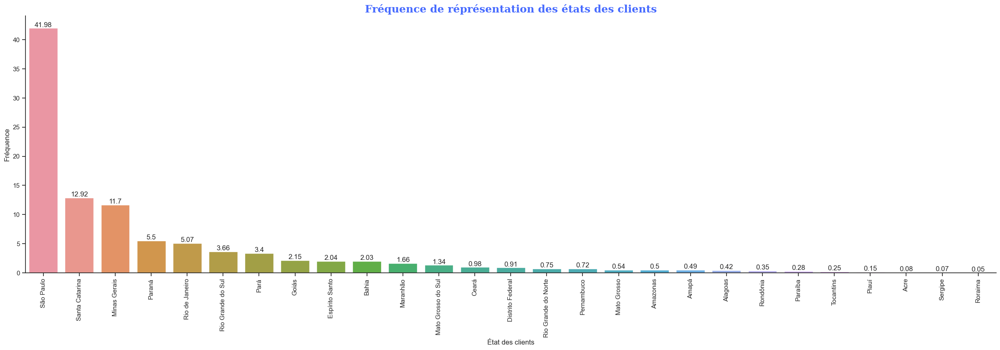

In [12]:
# paramètre du tracé
custom_params = {"axes.spines.right": False, "axes.spines.top": False}
sns.set_theme(style="ticks", rc=custom_params)
font_title = {"family": "serif", "color": "#476bff", "weight": "bold", "size": 18}

plt.figure(figsize = (30,8))

# calcul de la fréquence de représentation de chaque état
state_fre = round((data_customers["customer_state"].value_counts()/len(data_customers))*100, 2)

# Graphique de la réprésentation des différents états
ax = sns.barplot(x = data_customers["customer_state"].unique(), y=state_fre)
ax.set(xlabel = "État des clients", ylabel = "Fréquence")
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


# Ajout des valeurs au-dessus des barres
for i, v in enumerate(state_fre):
    ax.text(i, v, str(v), ha = "center", va = "bottom")

plt.title("Fréquence de réprésentation des états des clients", fontdict = font_title)
plt.show()

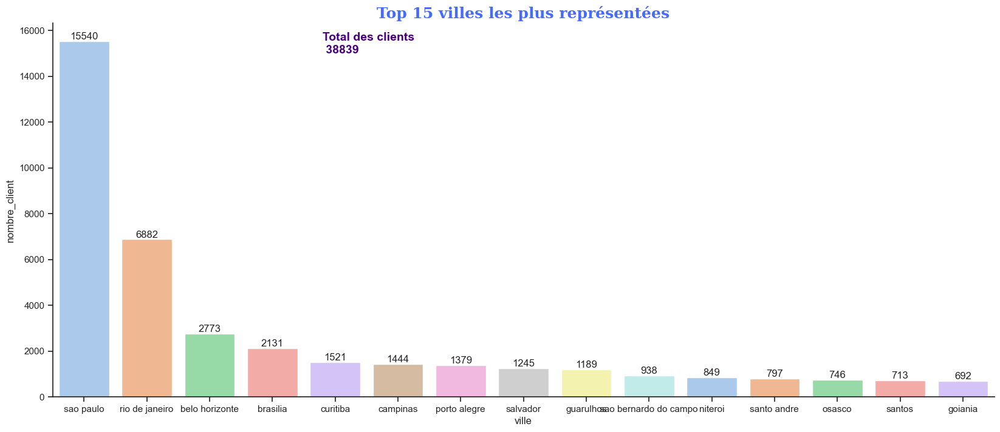

In [13]:
# paramètre du tracé
custom_params = {"axes.spines.right": False, "axes.spines.top": False}
sns.set_theme(style="ticks", rc=custom_params)
font_title = {"family": "serif", "color": "#476bff", "weight": "bold", "size": 18}

# Créer une figure et un axe pour le graphique
fig, ax = plt.subplots(figsize=(20,8))


# Calcul du nombre de représentation des villes
data_ville = data_customers["customer_city"].value_counts().reset_index()
data_ville.columns = ["ville", "nombre_client"]

# Tri des données par ordre décroissant du nombre de clients
data_ville = data_ville.sort_values(by="nombre_client", ascending=False)

# Extraction des 15 premières villes
data_ville = data_ville.head(15)

# Extraction des données x et y pour les tracés
x = data_ville["ville"]
y = data_ville["nombre_client"]


# Tracer un diagramme à barres pour chaque point du graphique
sns.barplot(x = x, y = y, data = data_ville, palette = "pastel")

# Ajout des valeurs au-dessus des barres
for i, v in enumerate(data_ville["nombre_client"]):
    ax.text(i, v, str(v), ha = "center", va = "bottom")
    
# Ajout d'un texte supplémentaire
ax.text(p.get_x() / 2, 15000, 'Total des clients\n %s' % data_ville["nombre_client"].sum(), 
        fontweight = "bold", color = "indigo", fontsize=14)

# Titre du tracé
plt.title("Top 15 villes les plus représentées", fontdict=font_title)

# Impression
plt.show()

Environ 40% des clients (15.540) résides à Sao Paulo et un peu moins de 18% à Rio de janeiro. Ce résultat n'est pas supprenant, car ces deux villes sont les plus peuplés du Brésil.

**_Résumé :_**

La trame de données "data_customer" ne contient : aucun doublon, aucune valeur manquante. Elle contient des informations qui permettent d'identifier les clients et de les géolocaliser. Toutes les variables de ce jeu de données seront utiles pour ce projet, par conséquent la trame de données est prête pour la fusion.

##### <font color = "blue"> 2. La géolocalisation

In [14]:
# Affichage des 5 premières lignes
data_localisation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [15]:
# Affichage des informations desciptives des colonnes
skim(data_localisation)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                 Data Types                                                                │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                         │
│ ┃ dataframe         ┃ Values  ┃ ┃ Column Type ┃ Count ┃                                                         │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                         │
│ │ Number of rows    │ 1000163 │ │ float64     │ 2     │                                                         │
│ │ Number of columns │ 5       │ │ string      │ 2     │                                                         │
│ └───────────────────┴─────────┘ │ int32       │ 1     │                                                         │
│                                 └─────────────┴───────┘                                                         │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┓  │
│ ┃ column_name               ┃ NA  ┃ NA %   ┃ mean    ┃ sd      ┃ p0    ┃ p25    ┃ p75    ┃ p100    ┃ hist    ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━┩  │
│ │ geolocation_zip_code      │   0 │      0 │   37000 │   31000 │  1000 │  11000 │  64000 │  100000 │ █▄▃▁▂▃  │  │
│ │ geolocation_lat           │   0 │      0 │     -21 │     5.7 │   -37 │    -24 │    -20 │      45 │   ██▁   │  │
│ │ geolocation_lng           │   0 │      0 │     -46 │     4.3 │  -100 │    -49 │    -44 │     120 │    █    │  │
│ └───────────────────────────┴─────┴────────┴─────────┴─────────┴───────┴────────┴────────┴─────────┴─────────┘  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                       ┃ NA     ┃ NA %      ┃ words per row             ┃ total words           ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━┩  │
│ │ geolocation_city                  │      0 │         0 │                       1.8 │               1800000 │  │
│ │ geolocation_state                 │      0 │         0 │                       1.8 │               1800000 │  │
│ └───────────────────────────────────┴────────┴───────────┴───────────────────────────┴───────────────────────┘  │
╰────────────────────────────────────────────────────── End ──────────────────────────────────────────────────────╯

**_Observations :_** <br>

- Les colonness intitulées "geolocation_zip_code_prefix", "geolocation_city"et "geolocation_state" renseignent respectivement les CP, noms des villes et des états. Ces informations sont déjà présentes dans la trame "data_customers", je les supprimerais.
- Grâce aux coordonnées géographiques, on pourra visualiser les localisations des clients sur une carte ;
- La colonne code postal est au mauvais formant, je vais modifier cela.

In [16]:
# Transformation de la colonne "geolocation_zip_code_prefix" en type object
data_localisation['geolocation_zip_code_prefix'] = data_localisation['geolocation_zip_code_prefix'].astype('object').apply(lambda x: str(x).replace('.0', ''))

In [17]:
# Recherche de doublons
data_localisation.duplicated(subset=['geolocation_zip_code_prefix', "geolocation_lat", "geolocation_lng"]).sum()

280009

In [18]:
duplicates_mask = data_localisation.duplicated()  # Obtention du masque booléen des doublons
duplicates = data_localisation[duplicates_mask]  # Extraction des lignes correspondantes aux doublons
duplicates.head(50)

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
15,1046,-23.546081,-46.644820,sao paulo,SP
44,1046,-23.546081,-46.644820,sao paulo,SP
65,1046,-23.546081,-46.644820,sao paulo,SP
66,1009,-23.546935,-46.636588,sao paulo,SP
67,1046,-23.546081,-46.644820,sao paulo,SP
72,1046,-23.545320,-46.644069,sao paulo,SP
79,1050,-23.549854,-46.643139,sao paulo,SP
80,1032,-23.540775,-46.635515,sao paulo,SP
82,1046,-23.546081,-46.644820,sao paulo,SP
86,1048,-23.547449,-46.640169,são paulo,SP


_Plusieurs latitude et longitude différentes partage le même code postale, ce qui pourrait poser problème lors de la jointure des données. Je vais donc regrouper les données par code postal et faire la moyenne des latitude et longitude pour chaque code postal donnée._

In [19]:
# Regrouper les latitudes/longitudes par leurs moyennes
data_localisation = data_localisation.groupby('geolocation_zip_code_prefix').agg({'geolocation_lat': 'mean', 'geolocation_lng': 'mean','geolocation_city': 'first', 'geolocation_state': 'first'}).reset_index()

In [20]:
# Vérification
data_localisation.duplicated().sum()

0

In [21]:
data_localisation.head(2)

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1001,-23.550190,-46.634024,sao paulo,SP
1,1002,-23.548146,-46.634979,sao paulo,SP


In [22]:
# suppression des colonnes inutiles
data_localisation.drop(columns=["geolocation_city", "geolocation_state"], inplace=True)

**_Géolocalisation des clients sur une carte_**

In [23]:
# Importation des librairies utilent pour l'affichage de la carte
import folium
import folium.plugins

In [24]:
# coordonnées de Olist
Latitude_Seattle = -25.43045
Longitude_Seattle = -49.29207


# Tracer de la carte du Brésil
client_olist = folium.Map(location=[-25.43045, -49.29207], )

# Localisation des clients sur la carte du Brésil
marker_cluster = folium.plugins.MarkerCluster().add_to(client_olist)
for lat, lng, in zip(data_localisation.geolocation_lat, data_localisation.geolocation_lng):
    folium.Marker(location=[lat, lng]).add_to(marker_cluster)

client_olist

##### <font color = "blue"> 3. Informations sur les commandes <br>
    
<font color = "blue"> **_a) data_items_**

In [25]:
# Visualisation des 5 premières lignes
data_items.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [26]:
# Résumé du jeu de données
skim(data_items)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 112650 │ │ string      │ 4     │                                                          │
│ │ Number of columns │ 7      │ │ float64     │ 2     │                                                          │
│ └───────────────────┴────────┘ │ int32       │ 1     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━┓  │
│ ┃ column_name           ┃ NA   ┃ NA %    ┃ mean    ┃ sd      ┃ p0      ┃ p25    ┃ p75   ┃ p100    ┃ hist     ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━┩  │
│ │ order_item_id         │    0 │       0 │     1.2 │    0.71 │       1 │      1 │     1 │      21 │    █     │  │
│ │ price                 │    0 │       0 │     120 │     180 │    0.85 │     40 │   130 │    6700 │    █     │  │
│ │ freight_value         │    0 │       0 │      20 │      16 │       0 │     13 │    21 │     410 │    █     │  │
│ └───────────────────────┴──────┴─────────┴─────────┴─────────┴─────────┴────────┴───────┴─────────┴──────────┘  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                          ┃ NA    ┃ NA %      ┃ words per row            ┃ total words          ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━┩  │
│ │ order_id                             │     0 │         0 │                        1 │               110000 │  │
│ │ product_id                           │     0 │         0 │                        1 │               110000 │  │
│ │ seller_id                            │     0 │         0 │                        1 │               110000 │  │
│ │ shipping_limit_date                  │     0 │         0 │                        1 │               110000 │  │
│ └──────────────────────────────────────┴───────┴───────────┴──────────────────────────┴──────────────────────┘  │
╰────────────────────────────────────────────────────── End ──────────────────────────────────────────────────────╯

In [27]:
data_items.duplicated().sum()

0

**_Observations :_**

- Le tableau contient 7 colonnes et 112.650 lignes : les lignes correspondent aux identifiants des commandes et les colonnes les infromations de la commande (nombre d'article, date de livraison, nom du vendeur, prix, etc.) ;
- Le tableau ne contient aucun doublon ni valeur manquante ;
- La colonne renseignant la date de livraison n'est pas au format date. Ceci est à corriger.

**_Changement du format de la colonne "shipping_limit_date"_**

In [28]:
from datetime import datetime 
data_items["shipping_limit_date"] = data_items["shipping_limit_date"].apply(pd.to_datetime, format = "%Y-%m-%d %H:%M:%S")

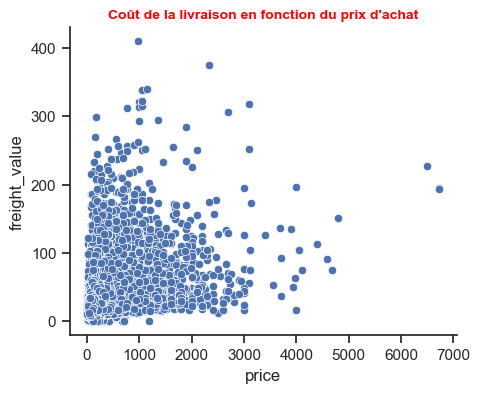

In [29]:
plt.figure(figsize = (5, 4))
sns.scatterplot(data = data_items, x = data_items["price"], y = data_items["freight_value"])

plt.title("Coût de la livraison en fonction du prix d'achat", fontsize = 10, fontweight = "bold", color = "red")
plt.show()

Le coût de la livraison est lié de manière linéaire au prix d'achat des articles.

**_Relation entre les frais de livraison et le nombre d'article commandé_**

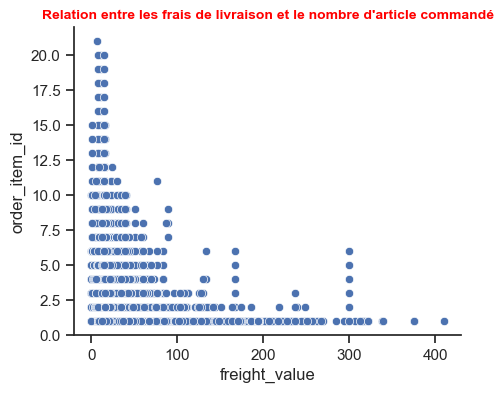

In [30]:
plt.figure(figsize = (5, 4))
sns.scatterplot(data = data_items, y = data_items["order_item_id"], x = data_items["freight_value"])

plt.title("Relation entre les frais de livraison et le nombre d'article commandé", fontsize = 10, fontweight = "bold", color = "red")
plt.show()

Le coût de la livraison ne dépend pas du nombre d'article acheté.

<font color = "blue"> **_b) data_orders_**

In [31]:
# Visualisation des 5 premières lignes
data_orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [32]:
# Résumé du jeu de données data_orders
skim(data_orders)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 99441  │ │ string      │ 8     │                                                          │
│ │ Number of columns │ 8      │ └─────────────┴───────┘                                                          │
│ └───────────────────┴────────┘                                                                                  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                         ┃ NA        ┃ NA %     ┃ words per row           ┃ total words         ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩  │
│ │ order_id                            │         0 │        0 │                       1 │               99000 │  │
│ │ customer_id                         │         0 │        0 │                       1 │               99000 │  │
│ │ order_status                        │         0 │        0 │                       1 │               99000 │  │
│ │ order_purchase_times                │         0 │        0 │                       1 │               99000 │  │
│ │ order_approved_at                   │       160 │     0.16 │                       1 │               99000 │  │
│ │ order_delivered_carr                │      1800 │      1.8 │                       1 │               99000 │  │
│ │ order_delivered_cust                │      3000 │        3 │                       1 │               99000 │  │
│ │ order_estimated_deli                │         0 │        0 │                       1 │               99000 │  │
│ └─────────────────────────────────────┴───────────┴──────────┴─────────────────────────┴─────────────────────┘  │
╰────────────────────────────────────────────────────── End ──────────────────────────────────────────────────────╯

In [33]:
# Recherche d'éventuels doublons
data_orders.duplicated().sum()

0

**_Observations :_** <br>
- Le tableau contient des valeurs manquantes qui devront être explorées ;
- Toutes les colonnes sont de types object, pourtant nous avons des colonnes qui renseignent des dates. Ces dernières vont être converties au bon format (date) ;
- Le jeu de données renseigne des informations relatives aux suivis des commandes par client ;
- La colonne "customer_id" est redondante, car elle était déjà présente dans la trame de données "data_customers".

**_Changement du format des colonnes en type date_**

In [34]:
# Création d'une liste contenant les colonnes de date

col_date = ["order_purchase_timestamp", "order_approved_at", "order_delivered_carrier_date",
            "order_delivered_customer_date", "order_estimated_delivery_date"]

# Changement de format
data_orders[col_date] = data_orders[col_date].apply(pd.to_datetime, format = "%Y-%m-%d %H:%M:%S")

Visualisation graphique des états de traitements des commandes

In [35]:
data_orders["order_status"].unique()

array(['delivered', 'invoiced', 'shipped', 'processing', 'unavailable',
       'canceled', 'created', 'approved'], dtype=object)

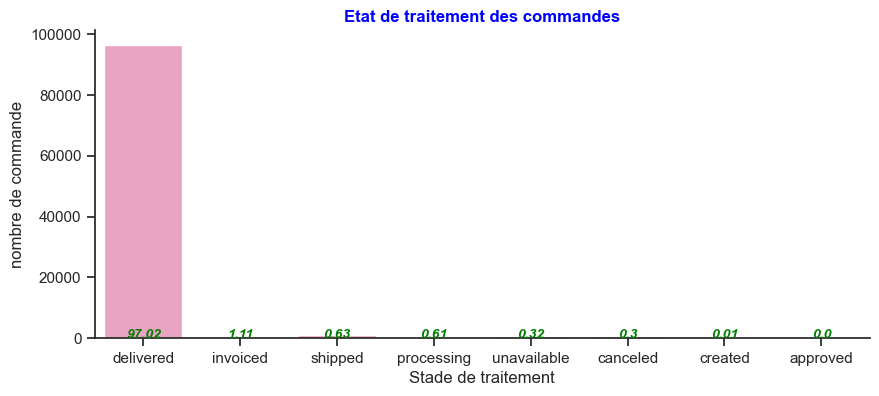

In [36]:
# paramètre du graphe
plt.figure(figsize = (10, 4))

# Tracé du graphe
ax = sns.countplot(data = data_orders, x = "order_status", color = "#F498C2")
ax.set(xlabel = "Stade de traitement", ylabel = "nombre de commande") # Titre des axes

# Calcul des pourcentage à afficher au-dessus des barres
statut = round((data_orders["order_status"].value_counts()/len(data_orders) * 100), 2)

# Ajout des pourcentages sur les barres
for i, v in enumerate(statut):
    ax.text(i, v, str(v), ha = "center", va = "baseline", 
            fontstyle = "italic", fontsize = "small", color = "green", fontweight = "bold")

# Titre de la figure
plt.title("Etat de traitement des commandes", fontsize = 12, fontweight = "bold", color = "blue")

# impression
plt.show()

97% des commandes sont livrées et moins de 1% sont annulées. <br>

**_Calcul de la durée moyenne de livraison_**

In [37]:
# Création d'une nouvelle colonne correspondant à la durée de livraison par commande
data_orders["delivery_time"] = (data_orders["order_delivered_customer_date"] - data_orders["order_purchase_timestamp"])

In [38]:
# Calcul de la durée moyenne de livraison
temps_livraison = data_orders["delivery_time"].mean()

# Extraction du jour
temps_livraison = temps_livraison.days

# Impression du résultat
print("La durée moyenne de livraison des articles est de :", temps_livraison, "jours")

La durée moyenne de livraison des articles est de : 12 jours


**_Y a t'il des périodes de forte activité ou les ventes sont stables tous les mois de l'année ?_** 

Pour répondre à cette question, je vais visualiser graphiquement l'évolution de l'activité au cours des mois.

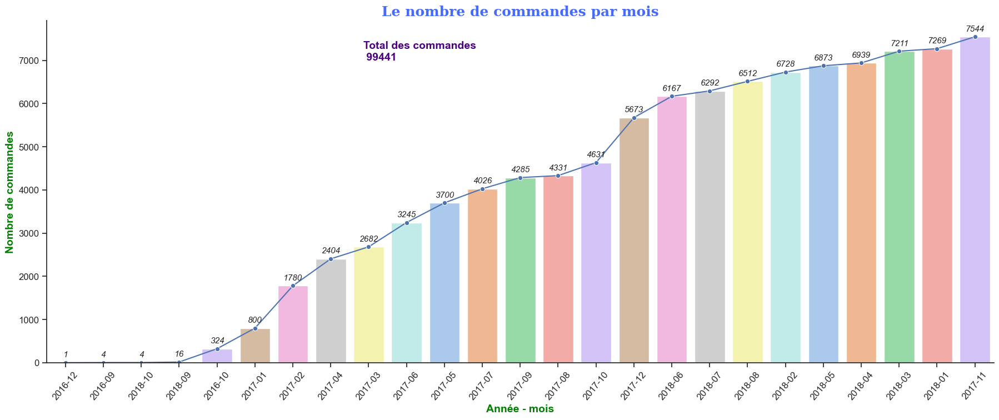

In [39]:
# Création d'une copie du DataFrame des commandes
monthly_order = data_orders.copy()

# Conversion de la colonne "order_purchase_timestamp" en année-mois
monthly_order["order_purchase_timestamp"] = monthly_order["order_purchase_timestamp"].dt.strftime('%Y-%m')

# Comptage du nombre de commandes par mois en utilisant la fonction value_counts()
monthly_order = monthly_order["order_purchase_timestamp"].value_counts().reset_index().sort_values("order_purchase_timestamp")
monthly_order.columns = ["order_purchase_timestamp", "number_order"]

# Extraction des données x et y pour les tracés
x = monthly_order["order_purchase_timestamp"]
y = monthly_order["number_order"]

# Création de la figure et des axes
fig, ax = plt.subplots(figsize=(22, 8))

# Tracé de la ligne
sns.lineplot(x = x, y = y, data = monthly_order, marker = 'o')

# Tracé des barres
sns.barplot(x = x, y = y, data = monthly_order, palette = "pastel")

# Ajout des annotations sur les barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    plt.annotate("%.0f" % p.get_height(),
                 (p.get_x() + p.get_width() / 2, p.get_height()),
                 ha = "center",
                 va = "center",
                 xytext = (0, 10),
                 textcoords = "offset points",
                 fontsize = 11, fontstyle = "italic")

# Configuration des axes
ax.set_ylabel('Nombre de commandes', fontsize = 14, fontweight = "bold", color = "green")

plt.xticks(rotation = 50, fontsize = 12)
plt.yticks(fontsize = 12)
plt.xlabel("Année - mois", fontsize = 14, fontweight = "bold", color = "green")

# Ajout d'un texte supplémentaire
ax.text(p.get_x() / 3, 7000, 'Total des commandes\n %s' % monthly_order['number_order'].sum(), 
        fontweight = "bold", color = "indigo", fontsize=14)

# Titre du graphique
plt.title("Le nombre de commandes par mois", fontdict = font_title)

# Affichage du graphique
plt.show()

**_observations :_** <br>
* Au premier trimestre 2018 et en novembre 2017, l'entreprise a enregistré son plus haut niveau d'activité. Les fêtes de fin d'année semblent y avoir fortement contribué. 
* Le niveau d'activité était très bas en 2016 et a progressivement augmenté année après année pour se stabiliser en 2018 ;
* De Octobre 2016 à août 2018, l'entreprise à traité 96478 commandes. <br> 

L'accroissement de l'activité année après année suppose que l'entreprise à conquis de nouveaux clients et que probablement de nouveaux vendeurs se sont installés sur la marketplace. On peut alors observer le nombre de clients actifs et vendeurs par mois. Pour cela, je dois procéder à la fusion des trames de données "data_customers", "data_items" et data_orders.

<font color = "blue"> **_c) Fusion des 4 trames de données_**

In [40]:
# Création d'un dataframe pour la fusion des trames de données
data = pd.DataFrame()

In [41]:
# Fusion des trames "data_customers" et "data_orders" à partir de leur colonne commune "customer_id"
data = data_orders.merge(data_customers, on = "customer_id")

In [42]:
data = pd.merge(data, data_localisation, left_on='customer_zip_code_prefix', right_on='geolocation_zip_code_prefix', how='left')

In [43]:
# Fusion des dataframe "data" et "data_items" à partir de la colonne commune "order_id"
data = data.merge(data_items, on = "order_id") 

In [44]:
# visualisation des 5 premières lignes pour vérifier la qualité de la fusion au niveau des colonnes
data.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,delivery_time,customer_unique_id,...,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,...,São Paulo,3149,-23.576983,-46.587161,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,13 days 18:46:08,af07308b275d755c9edb36a90c618231,...,Bahia,47813,-12.177924,-44.660711,1,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,9 days 09:27:40,3a653a41f6f9fc3d2a113cf8398680e8,...,Goiás,75265,-16.745150,-48.514783,1,aa4383b373c6aca5d8797843e5594415,4869f7a5dfa277a7dca6462dcf3b52b2,2018-08-13 08:55:23,159.90,19.22
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,13 days 05:00:36,7c142cf63193a1473d2e66489a9ae977,...,Rio Grande do Norte,59296,-5.774190,-35.271143,1,d0b61bfb1de832b15ba9d266ca96e5b0,66922902710d126a0e7d26b0e3805106,2017-11-23 19:45:59,45.00,27.20
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,2 days 20:58:23,72632f0f9dd73dfee390c9b22eb56dd6,...,São Paulo,9195,-23.676370,-46.514627,1,65266b2da20d04dbe00c5c2d3bb7859e,2c9e548be18521d1c43cde1c582c6de8,2018-02-19 20:31:37,19.90,8.72


In [45]:
data.isnull().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                  15
order_delivered_carrier_date     1194
order_delivered_customer_date    2454
order_estimated_delivery_date       0
delivery_time                    2454
customer_unique_id                  0
customer_zip_code_prefix            0
customer_city                       0
customer_state                      0
geolocation_zip_code_prefix       302
geolocation_lat                   302
geolocation_lng                   302
order_item_id                       0
product_id                          0
seller_id                           0
shipping_limit_date                 0
price                               0
freight_value                       0
dtype: int64

In [46]:
data.shape

(112650, 22)

**_Suppression des colonnes non pertinentes_**

In [47]:
data.drop(["order_approved_at", "order_delivered_carrier_date",
                  "order_estimated_delivery_date", "shipping_limit_date"], axis = 1, inplace = True)

**_Evolution de la clientèle au fil des mois_**

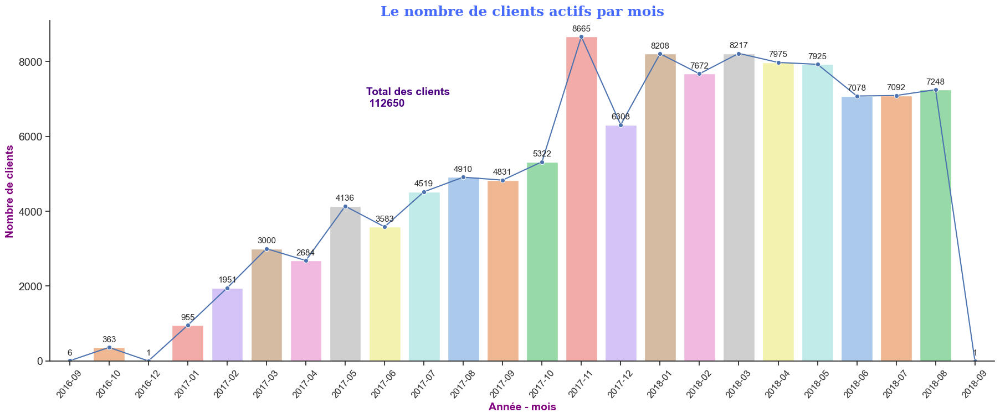

In [48]:
# Copier des données dans un nouveau dataframe pour la manipulation
client_evol = data.copy()

# Restreinte de la colonne "order_purchase_timestamp" au format année-mois
client_evol["order_purchase_timestamp"] = client_evol["order_purchase_timestamp"].dt.strftime("%Y-%m")

# Regrouper les données par mois et compter le nombre de client par mois
client_evol = client_evol.groupby(["order_purchase_timestamp"]).agg({"customer_unique_id" : "count"}).reset_index()

# Renommer les colonnes
client_evol.columns = ["order_purchase_timestamp", "nombre_client"]

# Définition des valeurs x et y pour le tracé
x = client_evol["order_purchase_timestamp"]
y = client_evol["nombre_client"]

# Créer une figure et un axe pour le graphique
fig, ax = plt.subplots(figsize=(22,8))

# Tracer une ligne reliant les points du graphique et ajouter des marqueurs pour chaque point
sns.lineplot(x = x, y = y, data = client_evol, marker = "o")

# Tracer un diagramme à barres pour chaque point du graphique
sns.barplot(x = x, y = y, data = client_evol, palette = "pastel")

# Changer le style des axes en 'darkgrid'
sns.axes_style("darkgrid")

# Ajouter des annotations pour chaque barre du diagramme à barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy() 
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha = "center",
                va = "center",
                xytext = (0, 10),
                textcoords = "offset points",
                fontsize = 11)

# Ajouter une étiquette pour l'axe y
ax.set_ylabel("Nombre de clients", fontsize = 14, fontweight = "bold", color = "purple")

# Changer la taille des étiquettes sur les axes x et y
plt.xticks(rotation = 50, fontsize = 12)
plt.yticks(fontsize = 14)

# Ajouter une étiquette vide pour l'axe x
plt.xlabel("Année - mois", fontsize = 14, fontweight = "bold", color = "purple")

# Ajouter une annotation pour le nombre total de clients dans le coin supérieur gauche du graphique
ax.text(p.get_x() / 3, 6800,'Total des clients\n %s' % client_evol["nombre_client"].sum(),
        fontweight = "bold", color = "indigo", fontsize=14)

# Ajouter un titre au graphique
plt.title('Le nombre de clients actifs par mois', fontdict = font_title)

# Afficher le graphique
plt.show()

**_Remarques :_** <br> Les périodes où l'Olist à enregistré de grands nombres de commandes correspondent aux périodes où le nombre de client étaient le plus élevé. <br> Cette observation révèle que l'accroissement de l'activité de l'entreprise dépend exclissivement de l'acquisition d'une nouvelle clientèle. En effet, seulement 97% des clients n'ont effectué qu'une seule commande.

Le but de ce projet est l'étude de la clientèle mais, on peut aussi regarder l'évolution des vendeurs par mois pour savoir commment la marketplace repond aux besoins des clients.

**_Evolution des vendeurs par mois_**

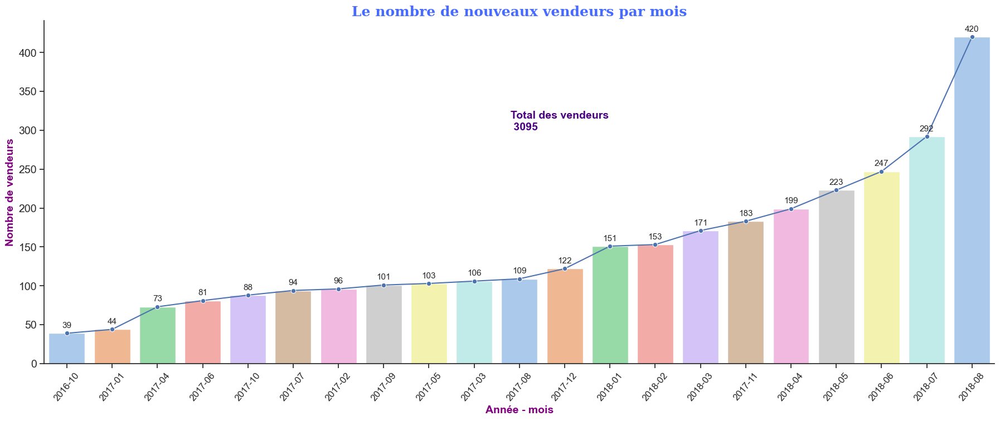

In [49]:
# Copie des données dans un nouveau DataFrame
seller_evol = data.copy()

# Suppression des doublons
seller_evol = seller_evol.drop_duplicates(subset = "seller_id", keep = "first")

# Trier les données par ordre décroissant de 'seller_id' et 'order_purchase_timestamp'
seller_evol = seller_evol.sort_values(by = ['seller_id', 'order_purchase_timestamp'], ascending = False)

# Convertir la colonne 'order_purchase_timestamp' en format 'année-mois'
seller_evol["order_purchase_timestamp"] = seller_evol["order_purchase_timestamp"].dt.strftime('%Y-%m')

# Regrouper les données par mois et compter le nombre de clients uniques pour chaque mois
data_evol = seller_evol["order_purchase_timestamp"].value_counts().reset_index().sort_values("order_purchase_timestamp")
data_evol.columns = ["order_purchase_timestamp", "nb_seller"]


# Extraire les valeurs de l'axe x et y pour tracer le graphique
x = data_evol['order_purchase_timestamp']
y = data_evol['nb_seller']

# Créer une figure et un axe pour le graphique
fig, ax = plt.subplots(figsize=(22,8))

# Tracer une ligne reliant les points du graphique et ajouter des marqueurs pour chaque point
sns.lineplot(x = x, y = y, data = data_evol, marker = "o")

# Tracer un diagramme à barres pour chaque point du graphique
sns.barplot(x = x, y = y, data = seller_evol, palette = "pastel")

# Changer le style des axes en 'darkgrid'
sns.axes_style("darkgrid")

# Ajouter des annotations pour chaque barre du diagramme à barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy() 
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha = "center",
                va = "center",
                xytext = (0, 10),
                textcoords = "offset points",
                fontsize = 11)

# Ajouter une étiquette pour l'axe y
ax.set_ylabel("Nombre de vendeurs", fontsize = 14, fontweight = "bold", color = "purple")

# Changer la taille des étiquettes sur les axes x et y
plt.xticks(rotation = 50, fontsize = 12)
plt.yticks(fontsize = 14)

# Ajouter une étiquette vide pour l'axe x
plt.xlabel("Année - mois", fontsize = 14, fontweight = "bold", color = "purple")

# Ajouter une annotation pour le nombre total de clients dans le coin supérieur gauche du graphique
ax.text(p.get_x() / 2, 300,'Total des vendeurs\n %s' % seller_evol['seller_id'].unique().size,
        fontweight = "bold", color = "indigo", fontsize=14)

# Ajouter un titre au graphique
plt.title('Le nombre de nouveaux vendeurs par mois', fontdict = font_title)

# Afficher le graphique
plt.show()

La marketplace compte 3096 vendeurs. Le nombre de vendeur a augmenté modestement mois après mois pour exploser après juin 2018 et atteindre son max en août 2018. <br> Je pourrais m'intéressé  aux vendeurs en regardant leur chiffre d'affaire, mais l'objectif de ce travail est centré sur la clientèle. 
Je vais donc poursuivre avec l'anlyse du comportement des clients en recherchant les jours et heures durant lesquels ils préfèrent réaliser leurs achats.

**_Profil hebdomadaire des clients_**

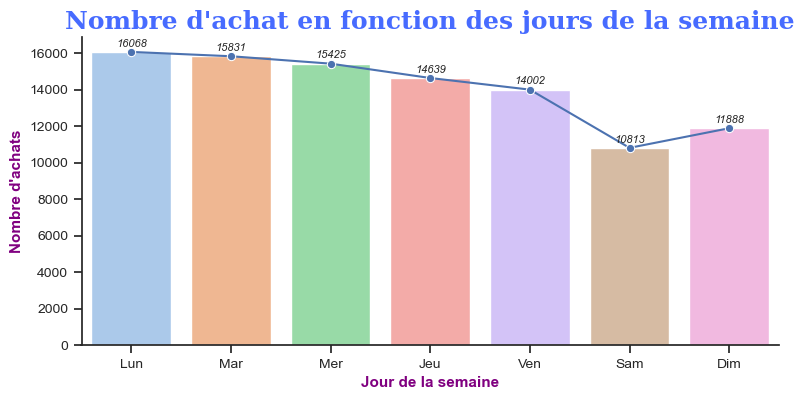

In [50]:
# Copie des données dans un nouveau DataFrame
jour_achat = data.copy()

# Convertir la colonne 'order_purchase_timestamp' en format 'jour'
jour_achat["order_purchase_timestamp"] = jour_achat["order_purchase_timestamp"].dt.dayofweek

# Regrouper les données par jour d'achat et compter le nombre d'achat 
jour_achat = jour_achat.groupby(["order_purchase_timestamp"]).agg({"order_id" : "nunique"}).reset_index()

# Renommer les colonnes
jour_achat.columns = ["order_purchase_timestamp", "nombre_achat"]

# Extraire les valeurs de l'axe x et y pour tracer le graphique
x = jour_achat['order_purchase_timestamp']
y = jour_achat['nombre_achat']

# Créer une figure et un axe pour le graphique
fig, ax = plt.subplots(figsize=(9, 4))

# Tracer une ligne reliant les points du graphique et ajouter des marqueurs pour chaque point
sns.lineplot(x = x, y = y, data = jour_achat, marker = "o")

# Tracer un diagramme à barres pour chaque point du graphique
sns.barplot(x = x, y = y, data = jour_achat, palette = "pastel")

# Changer le style des axes en 'darkgrid'
sns.axes_style("darkgrid")

# Ajouter des annotations pour chaque barre du diagramme à barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy() 
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha = "center",
                va = "center",
                xytext = (0, 6),
                textcoords = "offset points",
                fontsize = 8, fontstyle = "italic")

# Ajouter une étiquette pour l'axe y
ax.set_ylabel("Nombre d'achats", fontsize = 11, fontweight = "bold", color = "purple")

# Changer la taille des étiquettes sur les axes x et y
plt.yticks(fontsize = 10)
plt.xticks(np.arange(0,7), ['Lun','Mar','Mer','Jeu','Ven','Sam','Dim'], fontsize = 10)

# Ajouter une étiquette vide pour l'axe x
plt.xlabel("Jour de la semaine", fontsize = 11, fontweight = "bold", color = "purple")


# Ajouter un titre au graphique
plt.title("Nombre d'achat en fonction des jours de la semaine", fontdict = font_title)

# Afficher le graphique
plt.show()

**_Profil journalier des clients_**

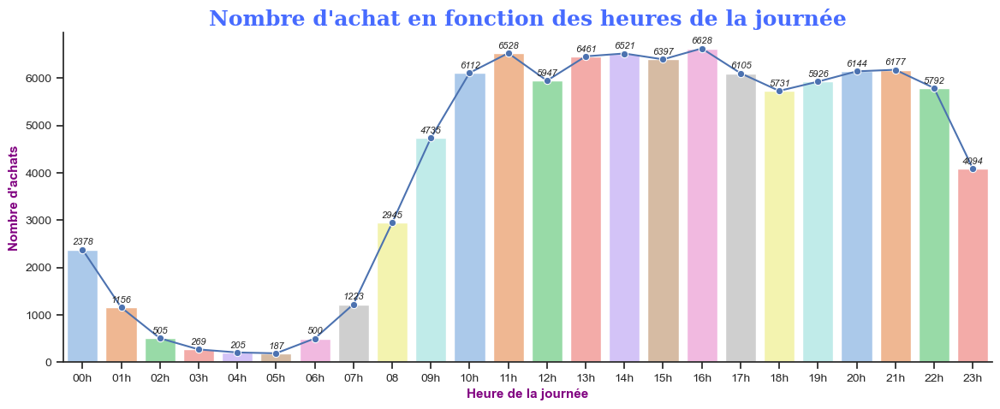

In [51]:
# Copie des données dans un nouveau DataFrame
jour_achat = data.copy()

# Convertir la colonne 'order_purchase_timestamp' en format 'jour'
jour_achat["order_purchase_timestamp"] = jour_achat["order_purchase_timestamp"].dt.hour

# Regrouper les données par jour d'achat et compter le nombre d'achat 
jour_achat = jour_achat.groupby(["order_purchase_timestamp"]).agg({"order_id" : "nunique"}).reset_index()

# Renommer les colonnes
jour_achat.columns = ["order_purchase_timestamp", "nombre_achat"]

# Extraire les valeurs de l'axe x et y pour tracer le graphique
x = jour_achat['order_purchase_timestamp']
y = jour_achat['nombre_achat']

# Créer une figure et un axe pour le graphique
fig, ax = plt.subplots(figsize=(14, 5))

# Tracer une ligne reliant les points du graphique et ajouter des marqueurs pour chaque point
sns.lineplot(x = x, y = y, data = jour_achat, marker = "o")

# Tracer un diagramme à barres pour chaque point du graphique
sns.barplot(x = x, y = y, data = jour_achat, palette = "pastel")

# Changer le style des axes en 'darkgrid'
sns.axes_style("darkgrid")

# Ajouter des annotations pour chaque barre du diagramme à barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy() 
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha = "center",
                va = "center",
                xytext = (0, 6),
                textcoords = "offset points",
                fontsize = 8, fontstyle = "italic")

# Ajouter une étiquette pour l'axe y
ax.set_ylabel("Nombre d'achats", fontsize = 11, fontweight = "bold", color = "purple")

# Changer la taille des étiquettes sur les axes x et y
plt.yticks(fontsize = 10)
plt.xticks(np.arange(24), ['00h','01h','02h','03h','04h','05h','06h', '07h',
                           '08', '09h', '10h', '11h', '12h', '13h', '14h', '15h',
                           '16h', '17h', '18h', '19h', '20h', '21h', '22h', '23h'], fontsize = 10)

# Ajouter une étiquette vide pour l'axe x
plt.xlabel("Heure de la journée", fontsize = 11, fontweight = "bold", color = "purple")


# Ajouter un titre au graphique
plt.title("Nombre d'achat en fonction des heures de la journée", fontdict = font_title)

# Afficher le graphique
plt.show()

**_Observations :_** <br> Les jours de commande les plus importants sont les jours ouvrables de la semaine. Les où on enregistre le plus de commande sont respectivements lundi, mardi, mercredi. L'activité est plus ralentie le week-end et le jour le moins important en termes de nombre de vente est le samedi.<br>

Les achats sont réalisés à toutes les heures de la journée mais, c'est entre 10h et 22h qu'on note une plus forte activité avec un pic entre 13 et 16h.

Ces observations laissent penser que la majorité des achats sont à titre professionnel. Je confirmerais cette hypothèse en me penchant sur les types d'articles les plus commandés.

**_Fidélisation de la clientèle :_**

A présent, je souhaite savoir si les clients achètent leurs articles auprès des mêmes vendeurs.

In [52]:
# Création d'une copie du jeu de donnée
customer_sellers = data.copy()

# Regroupement des données par client et récupération des vendeurs uniques associés à chaque client
customer_sellers = customer_sellers.groupby("customer_unique_id").agg({"seller_id" : "unique"}).reset_index()

# Comptage du nombre de vendeurs uniques pour chaque client 
customer_sellers["num_unique_seller"] = customer_sellers["seller_id"].apply(len)

# Vérification si le nombre de vendeurs uniques pour chaque client est égal à 1
customer_sellers["same_seller"] = customer_sellers["num_unique_seller"] == 1

customer_sellers.head(3)

,customer_unique_id,seller_id,num_unique_seller,same_seller
0,0000366f3b9a7992bf8c76cfdf3221e2,[da8622b14eb17ae2831f4ac5b9dab84a],1,True
1,0000b849f77a49e4a4ce2b2a4ca5be3f,[138dbe45fc62f1e244378131a6801526],1,True
2,0000f46a3911fa3c0805444483337064,[3d871de0142ce09b7081e2b9d1733cb1],1,True


Le DataFrame "customer_sellers" contient les informations sur les clients, les vendeurs uniques associés à chaque client, le nombre de vendeurs uniques et une colonne "same_seller" qui indique si chaque client réalise toujours ses achats chez le même vendeur (True) ou non (False). <br> Je peux à présent visualiser le pourcentage des clients ayant réalisé leur achat chez les mêmes clients.

In [53]:
round(customer_sellers["num_unique_seller"].value_counts()/len(customer_sellers)*100)

1     97.0
2      3.0
3      0.0
4      0.0
5      0.0
6      0.0
10     0.0
8      0.0
Name: num_unique_seller, dtype: float64

In [54]:
round(customer_sellers["same_seller"].value_counts()/len(customer_sellers)*100)

True     97.0
False     3.0
Name: same_seller, dtype: float64

Environ 97% des clients réalisent leurs achats chez les mêmes vendeurs. Et seulement 3% des clients achètent chez plusieurs vendeurs à la fois.
Ce phénomène est dû au fait que 97% des clients n'ont acheté qu'une seul fois sur la plateforme. Les 3% qui ont des vendeurs différents correspondent aux clients qui ont réalisés des achats contenant plus d'un article.

**_Quels sont les montant dépensés par les clients par mois : chiffre d'affaire mensuel de la plateforme_**

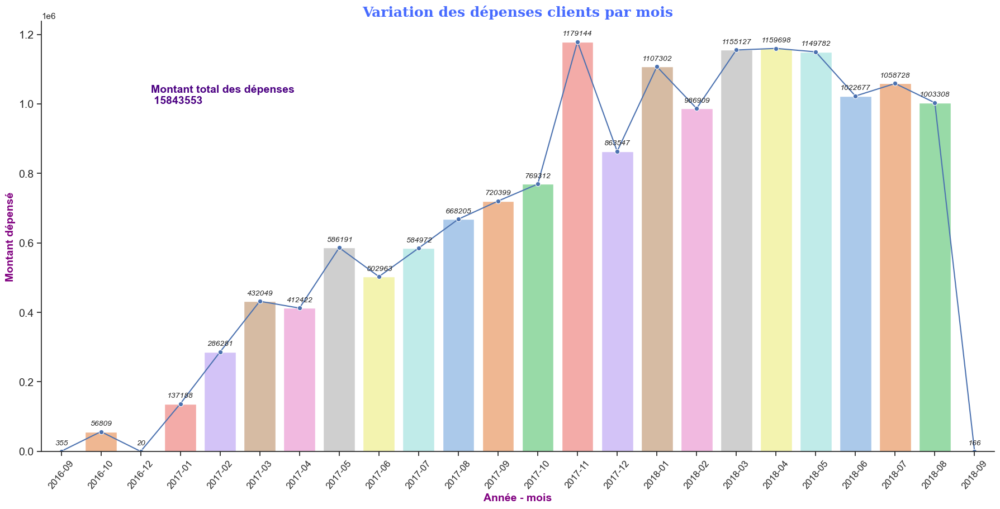

In [55]:
# Création d'une copie du jeu de données
montant_depense = data.copy()

# Restreinte de la colonne "order_purchase_timestamp" au format année-mois
montant_depense["order_purchase_timestamp"] = montant_depense["order_purchase_timestamp"].dt.strftime("%Y-%m")

# Calcul du montant total des dépenses
montant_depense["depenses"] = montant_depense["price"] + montant_depense["freight_value"]

# Regrouper les données par mois d'achat et compter le montant des dépenses
montant_depense = montant_depense.groupby("order_purchase_timestamp").agg({"depenses" : "sum"}).reset_index().sort_values("order_purchase_timestamp")

# Définition des valeurs X et y pour le tracé
x = montant_depense["order_purchase_timestamp"]
y = montant_depense["depenses"]

# Créer une figure et un axe pour le graphique
fig, ax = plt.subplots(figsize=(22,10))

# Tracer une ligne reliant les points du graphique et ajouter des marqueurs pour chaque point
sns.lineplot(x = x, y = y, data = montant_depense, marker = "o")

# Tracer un diagramme à barres pour chaque point du graphique
sns.barplot(x = x, y = y, data = montant_depense, palette = "pastel")

# Changer le style des axes en 'darkgrid'
sns.axes_style("darkgrid")

# Ajouter des annotations pour chaque barre du diagramme à barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy() 
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha = "center",
                va = "center",
                xytext = (0, 10),
                textcoords = "offset points",
                fontsize = 10, fontstyle = "italic")

# Ajouter une étiquette pour l'axe y
ax.set_ylabel("Montant dépensé", fontsize = 14, fontweight = "bold", color = "purple")

# Changer la taille des étiquettes sur les axes x et y
plt.xticks(rotation = 50, fontsize = 12)
plt.yticks(fontsize = 14)

# Ajouter une étiquette vide pour l'axe x
plt.xlabel("Année - mois", fontsize = 14, fontweight = "bold", color = "purple")

# Ajouter une annotation pour le nombre total de clients dans le coin supérieur gauche du graphique
ax.text(p.get_x() / 10, 1000000,'Montant total des dépenses\n %s' % round(montant_depense["depenses"].sum()),
        fontweight = "bold", color = "indigo", fontsize=14)

# Ajouter un titre au graphique
plt.title('Variation des dépenses clients par mois', fontdict = font_title)

# Afficher le graphique
plt.show()

Il avait été remarqué précedemment qu'il y a avait une corrélation de type linéaire possitif entre le coût d'achat et les frais de livraisons des articles. On peut aussi regarder comment varie le prix de la livraison en fonction du coût d'achat au fil des mois.

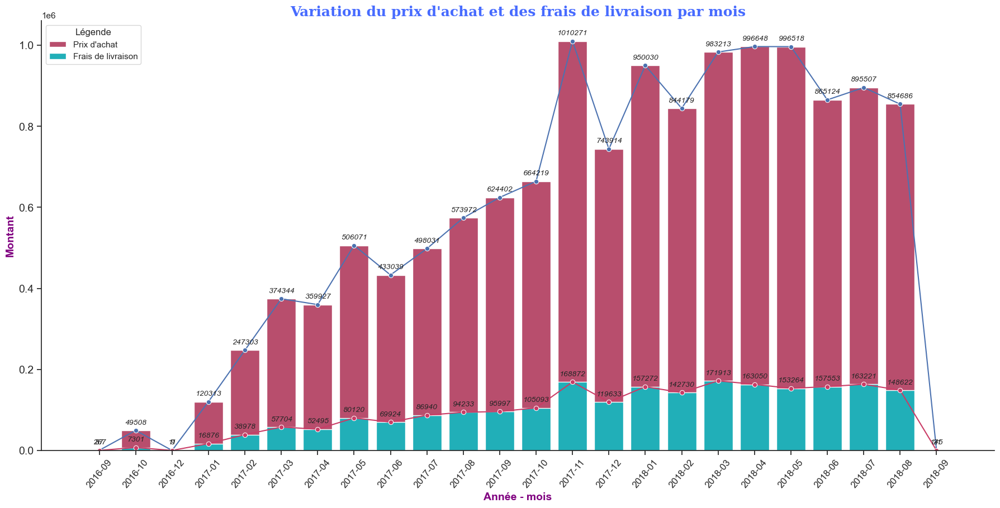

In [56]:
# Création d'une copie du jeu de données
frais_total = data.copy()

# Restreinte de la colonne "order_purchase_timestamp" au format année-mois
frais_total["order_purchase_timestamp"] = frais_total["order_purchase_timestamp"].dt.strftime("%Y-%m")

# Regrouper les données par mois d'achat et compter les frais de livraison et coût d'achat
frais_total = frais_total.groupby("order_purchase_timestamp").agg({"price" : "sum", "freight_value" : "sum"}).reset_index().sort_values("order_purchase_timestamp")

# Rennomer les colonnes
frais_total.columns = ["order_purchase_timestamp", "prix_achat", "frais_livraison"]

# Définition des valeurs X et y pour le tracé
x = frais_total["order_purchase_timestamp"]
y = frais_total["prix_achat"]
y_bis = frais_total["frais_livraison"]

# Créer une figure et un axe pour le graphique
fig, ax = plt.subplots(figsize=(22,10))

# Tracer un diagramme à barres pour le prix d'achat des articles
sns.barplot(x = x, y = y, data = frais_total, color = "#CA3C66", label = "Prix d'achat")
# Tracer une ligne reliant les points du graphique et ajouter des marqueurs pour chaque point
sns.lineplot(x = x, y = y, data = frais_total, marker = "o")

# Tracer un diagramme à barres pour les frais de livraison
sns.barplot(x = x, y = y_bis, data = frais_total, color = "#08C5D1", label = "Frais de livraison")
# Tracer une ligne reliant les points du graphique et ajouter des marqueurs pour chaque point
sns.lineplot(x = x, y = y_bis, data = frais_total, color = "#CA3C66", marker = "o")


# Changer le style des axes en 'darkgrid'
sns.axes_style("darkgrid")

# Affichage des labels
# Ajouter les labels pour les diagrammes à barres
plt.legend(title="Légende", loc="upper left")


# Ajouter des annotations pour chaque barre du diagramme à barres
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy() 
    plt.annotate("%.0f" % p.get_height(),
                (p.get_x()+p.get_width()/2, p.get_height()),
                ha = "center",
                va = "center",
                xytext = (0, 10),
                textcoords = "offset points",
                fontsize = 10, fontstyle = "italic")

# Ajouter une étiquette pour l'axe y
ax.set_ylabel("Montant", fontsize = 14, fontweight = "bold", color = "purple")

# Changer la taille des étiquettes sur les axes x et y
plt.xticks(rotation = 50, fontsize = 12)
plt.yticks(fontsize = 14)

# Ajouter une étiquette vide pour l'axe x
plt.xlabel("Année - mois", fontsize = 14, fontweight = "bold", color = "purple")


# Ajouter un titre au graphique
plt.title("Variation du prix d'achat et des frais de livraison par mois", fontdict = font_title)

# Afficher le graphique
plt.show()

**_Résumé :_** 

A la mise à disposition de ce jeu de données :
* 97% des commandes étaient complètement traitées avec une durée moyenne de livraison égale à 12 jours ;
* La market place a enregistré 99441 commandes, pour un montant global (prix des articles + frais de livraison) égal 15.843.553 R$ ;
* Le niveau d'activité est resté croissant de septembre 2016 à août 2018, avec un maximum atteint en novembre 2017 et au premier semestre 2018. L'augmentation de l'activité est dû à l'augmentation du nombre de vendeurs qui diversifie les offres et attirent de nouveaux clients ;
* Ces clients réalisent majoritairement leur achat les jours ouvrables de la semaine, entre 10h et 22h qui correspondent plus où moins aux horaires de travail classique. On peut se demander si les achats se font à titre professionnel?

##### <font color = "blue"> 3. Informations sur les articles <br>
<font color = "blue"> **_a) data_products_**

In [57]:
data_products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


Cet ensemble de données comprend les informations sur les produits vendus par Olist :
- Description des produits : dimensions, images etc ;
- L'identifiant de chaque produit ;
- Et les catégories auxquelles ils appartiennent.

Les colonnes qui nous interessent ici sont celles contenant les identifiants des produits et leurs catégories d'appartenance.

In [58]:
# Résumé de ces deux colonnes
skim(data_products[["product_id", "product_category_name"]])

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 32951  │ │ string      │ 2     │                                                          │
│ │ Number of columns │ 2      │ └─────────────┴───────┘                                                          │
│ └───────────────────┴────────┘                                                                                  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                          ┃ NA      ┃ NA %      ┃ words per row           ┃ total words         ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩  │
│ │ product_id                           │       0 │         0 │                       1 │               33000 │  │
│ │ product_category_nam                 │     610 │       1.9 │                       1 │               33000 │  │
│ └──────────────────────────────────────┴─────────┴───────────┴─────────────────────────┴─────────────────────┘  │
╰────────────────────────────────────────────────────── End ──────────────────────────────────────────────────────╯

La colonne renseignant les catégories des produits contient des valeurs manquantes et les valeurs sont écrites en portugais. Avant d'envisager un nettoyage et une traduction, je vais charger la trame de donnée "data_category", afin de voir si elle contient des informations complémentaires utiles.

<font color = "blue"> **_b) data_category_**

In [59]:
data_category.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [60]:
skim(data_category)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 71     │ │ string      │ 2     │                                                          │
│ │ Number of columns │ 2      │ └─────────────┴───────┘                                                          │
│ └───────────────────┴────────┘                                                                                  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                           ┃ NA    ┃ NA %      ┃ words per row            ┃ total words         ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩  │
│ │ product_category_nam                  │     0 │         0 │                        1 │                  71 │  │
│ │ product_category_nam                  │     0 │         0 │                        1 │                  71 │  │
│ └───────────────────────────────────────┴───────┴───────────┴──────────────────────────┴─────────────────────┘  │
╰────────────────────────────────────────────────────── End ──────────────────────────────────────────────────────╯

Cet ensemble de données contient la traduction des noms des catégories du portugais à l'anglais. Par conséquent il n'est plus utile de procéder à la traduction. <br> Etant donné que dans la trame de données "data_products", il y avait des catégories manquantes, je vais réaliser la fusion de ces deux trames de données, pour vérifier la qualité de la trduction et nettoyer les valeurs  si necessaire.

In [61]:
data_products = data_products.merge(data_category, on = "product_category_name")

Je vais vérifier que toutes les catégories de produits ont été traduite

In [62]:
# Recherche des valeurs manquantes de la colonne traduite correspondant aux valeurs non manquantes de la colonne en portugais
data_products[data_products["product_category_name_english"].isnull() & 
              data_products["product_category_name"].notnull()][['product_category_name',
                         'product_category_name_english']]

,product_category_name,product_category_name_english


Deux catégories n'ont pas été traduites, je vais corriger cela en remplaçant les valeurs manaquantes de la colonne "product_category_name_english", par la traduction correspondante

In [63]:
# Remplacer les valeurs manquantes par pc_gamer des lignes correspondantes
data_products.loc[(data_products["product_category_name"] == "pc_gamer"), "product_category_name_english"] = "pc_gamer"

# Remplacer les valeurs manquantes par la traduction en anglais de "portateis_cozinha_e_preparadores_de_alimentos"
data_products.loc[(data_products["product_category_name"] == "portateis_cozinha_e_preparadores_de_alimentos"),
                 "product_category_name_english"] = "kitchen_portables_and_food_preparators"

# Vérification de la correction
data_products[data_products["product_category_name_english"].isnull() & 
              data_products["product_category_name"].notnull()][['product_category_name',
                         'product_category_name_english']]

,product_category_name,product_category_name_english


La correction des valeurs non traduites étant faites, avant de poursuivre l'exploaration, je vais :
- Rupprimer la colonne "product_category_name" et les autres colonnes non pertinentes ;
- Renommer la colonne "product_category_name_english" avant de poursuivre l'exploaration.

_Suppression des colonnes_

In [64]:
# Regroupement des colonnes à supprimer dans une liste
colonnes = ["product_name_lenght", "product_description_lenght", "product_photos_qty",
           "product_weight_g", "product_length_cm", "product_height_cm", "product_width_cm", "product_category_name"]

# Suppression des colonnes de la trame de données
data_products.drop(colonnes, axis = 1, inplace = True)

In [65]:
# Renommer la colonne "product_category_name_english" en "product_category"
data_products.rename(columns = {"product_category_name_english" : "product_category"}, inplace = True)

In [66]:
# Résumé
skim(data_products)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 32328  │ │ string      │ 2     │                                                          │
│ │ Number of columns │ 2      │ └─────────────┴───────┘                                                          │
│ └───────────────────┴────────┘                                                                                  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                      ┃ NA     ┃ NA %      ┃ words per row              ┃ total words           ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━┩  │
│ │ product_id                       │      0 │         0 │                          1 │                 32000 │  │
│ │ product_category                 │      0 │         0 │                          1 │                 32000 │  │
│ └──────────────────────────────────┴────────┴───────────┴────────────────────────────┴───────────────────────┘  │
╰────────────────────────────────────────────────────── End ──────────────────────────────────────────────────────╯

1,9% des produits ne sont assigné à aucune des catégories. Je vais les remplacer les catégories non renseignées (NaN) par la "no_category"

In [67]:
# Remplacement des catégories manquantes par "no_category"
data_products["product_category"].fillna("no_category", inplace = True)

# Vérification du resultat
data_products.isna().sum()

product_id          0
product_category    0
dtype: int64

**_Quelles sont les catégories de produits les plus demandées_**

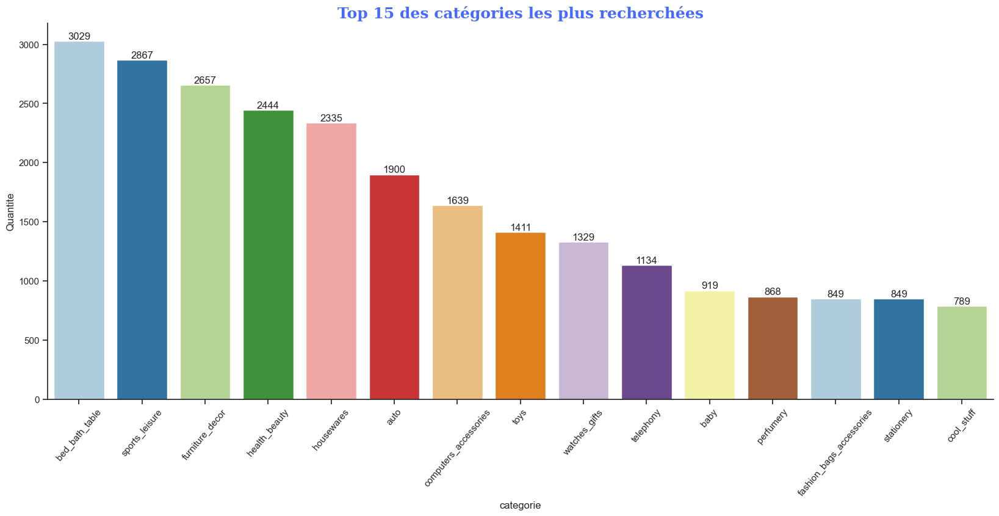

In [68]:
# paramètre du tracé
custom_params = {"axes.spines.right": False, "axes.spines.top": False}
sns.set_theme(style="ticks", rc=custom_params)
font_title = {"family": "serif", "color": "#476bff", "weight": "bold", "size": 18}
colors = sns.color_palette("Paired")

# Créer une figure et un axe pour le graphique
fig, ax = plt.subplots(figsize=(20,8))


# Calcul du nombre de représentation des catégories
article = data_products["product_category"].value_counts().reset_index()
article.columns = ["categorie", "Quantite"]

# Tri des données par ordre décroissant
article = article.sort_values(by="Quantite", ascending=False)

# Extraction des 15 catégories les plus recherchés
article = article.head(15)

# Extraction des données x et y pour les tracés
x = article["categorie"]
y = article["Quantite"]


# Tracer un diagramme à barres pour chaque point du graphique
sns.barplot(x = x, y = y, data = article, palette = colors)

# Configuration des axes
plt.xticks(rotation = 50)

# Ajout des valeurs au-dessus des barres
for i, v in enumerate(article["Quantite"]):
    ax.text(i, v, str(v), ha = "center", va = "bottom")
    

# Titre du tracé
plt.title("Top 15 des catégories les plus recherchées", fontdict=font_title)

# Impression
plt.show()

Les catégories de produits les plus recherchés sont en majorité les produits d'usage domestique et non professionnel

<font color = "blue"> **_c) Fusion des données_**

In [69]:
# Regroupement des trames de données à partir de leur colonne commune "product_id"
data = data.merge(data_products, on = "product_id")

# Visualisation des 3 premières lignes
data.head(3)

,order_id,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,order_item_id,product_id,seller_id,price,freight_value,product_category
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,3149,-23.576983,-46.587161,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,housewares
1,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-18 14:44:43,2 days 20:15:12,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,São Paulo,3366,-23.564630,-46.534268,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,housewares
2,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-07 18:30:01,5 days 00:05:14,ef0996a1a279c26e7ecbd737be23d235,2290,sao paulo,São Paulo,2290,-23.600462,-46.655318,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,housewares


##### <font color = "blue"> 4. Exploration des moyens de paiement

In [70]:
# Visualisation des 3 premières lignes
data_payment.head(3)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71


In [71]:
# Description de la trame de données
skim(data_payment)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 103886 │ │ string      │ 2     │                                                          │
│ │ Number of columns │ 5      │ │ int32       │ 2     │                                                          │
│ └───────────────────┴────────┘ │ float64     │ 1     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┓  │
│ ┃ column_name                  ┃ NA   ┃ NA %    ┃ mean   ┃ sd     ┃ p0   ┃ p25   ┃ p75   ┃ p100    ┃ hist    ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━━╇━━━━━━━━━┩  │
│ │ payment_sequential           │    0 │       0 │    1.1 │   0.71 │    1 │     1 │     1 │      29 │    █    │  │
│ │ payment_installments         │    0 │       0 │    2.9 │    2.7 │    0 │     1 │     4 │      24 │   █▂▁   │  │
│ │ payment_value                │    0 │       0 │    150 │    220 │    0 │    57 │   170 │   14000 │    █    │  │
│ └──────────────────────────────┴──────┴─────────┴────────┴────────┴──────┴───────┴───────┴─────────┴─────────┘  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                ┃ NA     ┃ NA %       ┃ words per row                ┃ total words              ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━┩  │
│ │ order_id                   │      0 │          0 │                            1 │                   100000 │  │
│ │ payment_type               │      0 │          0 │                            1 │                   100000 │  │
│ └────────────────────────────┴────────┴────────────┴──────────────────────────────┴──────────────────────────┘  │
╰────────────────────────────────────────────────────── End ──────────────────────────────────────────────────────╯

In [72]:
# Recherche de doublons
data_payment.duplicated().sum()

0

**_Observations :_** <br>
- Cet ensemble de données renseigne les informations sur les moyens de paiement des commandes utilisés par les clients.
- Il ne contient aucune valeurs manquante, ni doublons.

Je vais observer le moyen et la facilité de paiement les plus utilisés par les clients.

**_Moyen de paiement_**

In [73]:
# Recherche des moyens de paiement disponible
data_payment["payment_type"].unique()

array(['credit_card', 'boleto', 'voucher', 'debit_card', 'not_defined'],
      dtype=object)

In [74]:
# Calcul des pourcentages d'utilisations des moyens de paiement
frequence_paiement = data_payment["payment_type"].value_counts()/len(data_payment) * 100

In [75]:
import plotly.graph_objects as go
import plotly.express as px

In [76]:
# A l'aide de diagramme circulaire, je vais visualiser la répartition des différents moyen de paiement
labels = ["credit_card", "boleto", "voucher", "debit_card", "not_defined"]
fig = go.Figure(data=[go.Pie(labels=labels, values = frequence_paiement, hole=.3)])
fig.update_layout(title_text="Répartition des moyens de paiement")
fig.show()

Environ 74% des commandes sont réglés par carte de crédit et 20% en espèce (billet). L'utilisation des cartes à débit et des chèques est très peu répandu au sein de la clientèle.

**_Facilité de paiement_** <br>
Olist Offre aux clients la possibilité de régler leurs factures en plusieurs échéances. Ces informations sont renseignées dans la variable "payment_installments". Quel est le nombre d'échéance le plus récurrent ?

In [77]:
# Calcul des pourcentage d'utilisation de chaque échelonnement
mode_paiement = round(data_payment["payment_installments"].value_counts()/len(data_payment)*100, 2).reset_index()

# Renommer les colonnes
mode_paiement.columns = ["echelonnement", "pourcentage"]

# Représenter le resultat sous forme de graphique circulaire
fig = px.pie(mode_paiement, values='pourcentage', names='echelonnement', title='Répartition des échelonnements de paiement')
fig.update_traces(rotation=90)  # Fait pivoter le graphique de 90 degrés dans le sens horaire
fig.update_layout(width=800, height=600) # Dimmension du graphique
fig.show()

Plus de la moitié des commandes sont payées en une seule fois. Vient ensuite respectivement les paiements en 2, 3, 4 et 10 fois. Peut-on penser que les achats réaliser en plusieurs paiements correspondent aux produits les plus couteux ? <br> Je vais vérifier la relation entre ces deux variables à l'aide du nuage des points.

In [78]:
# Tracé du nuage de point des variables "payment_installments" et "payment_value"
fig = px.scatter(data_payment, x='payment_installments', y='payment_value', opacity=0.65,
                 trendline='ols', trendline_color_override='darkblue')
fig.update_layout(xaxis=dict(dtick=1, range=[0, 25]))  # Définit l'intervalle entre les graduations à 1 et les limites de l'axe x de 0 à 25
fig.show()

Il n'y a pas de corrélation entre le coût d'achat et l'échelonnement du paiement. <br> 
Cepenrdant, on peut remarquer sur le tracé ci-dessus : 
- Des paiements en "0 fois". Ceci sort de l'ordinaire, je vais regarder plus en détail ;
- Mais aussi un outlier : un paiement en une seule fois pour une valeur supérieure à 13K. Après fusion des données, je vérifierai à quoi correspond cette commande.

In [79]:
# Rechercher des paiement en 0 fois
data_payment[data_payment["payment_installments"] == 0]

,order_id,payment_sequential,payment_type,payment_installments,payment_value
46982,744bade1fcf9ff3f31d860ace076d422,2,credit_card,0,58.69
79014,1a57108394169c0b47d8f876acc9ba2d,2,credit_card,0,129.94


Ces paiements indiquer en 0 fois ont été effectué par deux moyens de paiement différent (payment_sequential = 2). Il semble qu'on est en présence d'une valeur abérrante, je vais remplacer l'échelonnement de paiement 0 par 1 (qui est la valeur modale pour cette variable).

In [80]:
# Remplacer la valeur 0 par la valeur 1 dans la colonne "payment_installments"
data_payment["payment_installments"].replace(0, 1, inplace = True)

**_Je peux à présent rajouter cet ensemble de données au jeu de données de fusion_**

In [81]:
# Fusion des données sur la colonne commune "order_id"
data = data.merge(data_payment, on = "order_id")

# Visualisation des 3 premières lignes 
data.head(3)

,order_id,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,...,order_item_id,product_id,seller_id,price,freight_value,product_category,payment_sequential,payment_type,payment_installments,payment_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,housewares,1,credit_card,1,18.12
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,housewares,3,voucher,1,2.00
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,housewares,2,voucher,1,18.59


**_Observation :_** <br> La colonne "payment_value" représente le montant total dépensé par achat c'est-à-dire la somme des colonnes "price" et "freight_value". Cependant les valeurs ne semblent pas correspondre, je vais vérifier et corriger cette observation

In [82]:
(data['price'] + data["freight_value"]).equals(data['payment_value'])

False

La somme du prix d'achat et des frais de transports est différente du montant total dépensé. Je vais corriger cela en créant une nouvelle colonne qui sera la somme des montants dépensés par chaque client.

In [83]:
# Création de la colonne "spend_total"
data["spend_total"] = data["price"] + data["freight_value"]

# Supprimer la colonne "payment_value"
data.drop("payment_value", axis = 1, inplace = True)

# Vérifier le resultat de l'opération
print((data['price'] + data["freight_value"]).equals(data['spend_total']))

# visualiser le resultat
data.head(3)

True


,order_id,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,...,order_item_id,product_id,seller_id,price,freight_value,product_category,payment_sequential,payment_type,payment_installments,spend_total
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,housewares,1,credit_card,1,38.71
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,housewares,3,voucher,1,38.71
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,housewares,2,voucher,1,38.71


Je vérifie à nouveau la relation entre l'échelonnement de paiement et le motant total des dépenses

In [84]:
# Tracé du nuage de point des variables "payment_installments" et "payment_value"
fig = px.scatter(data, x='payment_installments', y='spend_total', opacity=0.65,
                 trendline='ols', trendline_color_override='darkblue')
fig.update_layout(xaxis=dict(dtick=1, range=[0, 25]))  # Définit l'intervalle entre les graduations à 1 et les limites de l'axe x de 0 à 25
fig.show()

**_Observations :_** <br> 
- Il n'y a pas de corrélation entre le coût de la commande et le paiement échelonné ; 
- Cependant, on peut remarquer le montant maximal dépensé est inférieur à 13k comme s'était le cas précedemment. Il y avait donc belle et bien une erreur avec la variable "payment_value".

_On a vu que certains clients utilisaient plusieurs moyens de paiement. On peut alors afficher le moyen de paiment utilisé pour chaque commande_

In [85]:
# Regrouper les données par client et par type de paiement puis calculer du nombre de commande
mode_paiement = data.groupby(["customer_unique_id", "payment_type"]).agg({"order_id": "count"}).unstack() # Pivoter les données

# Suppression du niveau d'index supérieur dans les noms de colonnes
mode_paiement.columns = mode_paiement.columns.droplevel(0)

# Remplissage des valeurs manquantes avec 0, pour les cas où un client n'a pas utilisé le moyen d'achat correspondant.
mode_paiement.fillna(0, inplace=True)

# Rénitialiser les index
mode_paiement.reset_index(inplace = True)

# Visualiser le resultat
mode_paiement.head(3)

payment_type,customer_unique_id,boleto,credit_card,debit_card,voucher
0,0000366f3b9a7992bf8c76cfdf3221e2,0.0,1.0,0.0,0.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.0,1.0,0.0,0.0
2,0000f46a3911fa3c0805444483337064,0.0,1.0,0.0,0.0


In [86]:
# Fusion les données "mode_paiement" et "data" sur la colonne commune "customer_unique_id"
data = data.merge(mode_paiement, on = "customer_unique_id")

# Visualisation des 3 premières lignes 
data

,order_id,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,...,freight_value,product_category,payment_sequential,payment_type,payment_installments,spend_total,boleto,credit_card,debit_card,voucher
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,8.72,housewares,1,credit_card,1,38.71,0.0,2.0,0.0,2.0
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,8.72,housewares,3,voucher,1,38.71,0.0,2.0,0.0,2.0
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,8.72,housewares,2,voucher,1,38.71,0.0,2.0,0.0,2.0
3,69923a4e07ce446644394df37a710286,31f31efcb333fcbad2b1371c8cf0fa84,delivered,2017-09-04 11:26:38,2017-09-05 19:20:20,1 days 07:53:42,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,8.72,baby,1,credit_card,1,44.11,0.0,2.0,0.0,2.0
4,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-18 14:44:43,2 days 20:15:12,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,São Paulo,...,7.78,housewares,1,credit_card,3,37.77,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115873,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2017-08-23 15:36:29,12 days 18:15:22,fb9310710003399b031add3e55f34719,3318,sao paulo,São Paulo,...,18.12,sports_leisure,1,credit_card,10,374.12,0.0,2.0,0.0,0.0
115874,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2017-08-23 15:36:29,12 days 18:15:22,fb9310710003399b031add3e55f34719,3318,sao paulo,São Paulo,...,18.12,sports_leisure,1,credit_card,10,374.12,0.0,2.0,0.0,0.0
115875,cfa78b997e329a5295b4ee6972c02979,a2f7428f0cafbc8e59f20e1444b67315,delivered,2017-12-20 09:52:41,2018-01-26 15:45:14,37 days 05:52:33,a49e8e11e850592fe685ae3c64b40eca,83870,campo do tenente,Paraná,...,15.14,musical_instruments,1,credit_card,1,71.04,0.0,1.0,0.0,0.0
115876,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-17 15:08:01,8 days 05:13:56,6359f309b166b0196dbf7ad2ac62bb5a,12209,sao jose dos campos,São Paulo,...,13.08,health_beauty,1,credit_card,3,85.08,0.0,1.0,0.0,0.0


##### <font color = "blue"> 5. Exploration de la sastifaction des clients

In [87]:
# Afficher les 3 premières lignes
data_reviews.head(3)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24


In [88]:
skim(data_reviews)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 99224  │ │ string      │ 6     │                                                          │
│ │ Number of columns │ 7      │ │ int32       │ 1     │                                                          │
│ └───────────────────┴────────┘ └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━━┓  │
│ ┃ column_name          ┃ NA    ┃ NA %     ┃ mean     ┃ sd     ┃ p0   ┃ p25    ┃ p75    ┃ p100    ┃ hist      ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━━┩  │
│ │ review_score         │     0 │        0 │      4.1 │    1.3 │    1 │      4 │      5 │       5 │  ▂  ▁▃█   │  │
│ └──────────────────────┴───────┴──────────┴──────────┴────────┴──────┴────────┴────────┴─────────┴───────────┘  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                         ┃ NA         ┃ NA %     ┃ words per row           ┃ total words        ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━┩  │
│ │ review_id                           │          0 │        0 │                       1 │              99000 │  │
│ │ order_id                            │          0 │        0 │                       1 │              99000 │  │
│ │ review_comment_title                │      88000 │       88 │                       1 │              99000 │  │
│ │ review_comment_messa                │      58000 │       59 │                       1 │              99000 │  │
│ │ review_creation_date                │          0 │        0 │                       1 │              99000 │  │
│ │ review_answer_timest                │          0 │        0 │                       1 │              99000 │  │
│ └─────────────────────────────────────┴────────────┴──────────┴─────────────────────────┴────────────────────┘  │
╰────────────────────────────────────────────────────── End ──────────────────────────────────────────────────────╯

Cet ensemble de données comprend des données sur les avis rédigés par les clients sur leurs expériences d'achat après la réception de chaque commande. <br> Plusieurs valeurs sont manquantes pour les colonnes relatives aux commentaires : 
- 88% de valeurs manquantes pour la colonne "review_comment_title" ;
- 59% de valeurs manquantes pour la colonne "review_comment_message" ;
Compte tenu du trop grand nombre de valeurs manquantes pour ces colonnes, elles ne seront pas utiles pour ce travail. <br> 

Je vais analyser la satisfaction des clients à partir :
* Des notes attribuées ;
* Et de la longueur des messages dans les commentaires : en effet, la longueur du message d'un avis client peut fournir des informations supplémentaires et des détails spécifiques sur l'expérience du client.

In [89]:
# Calcul de la fréquence des scores (en pourcentage)
note = round(data_reviews["review_score"].value_counts()/len(data_reviews)*100, 2)

# Calcul du score moyen attribué
moyenne = round(data_reviews["review_score"].mean(), 1)
moyenne

4.1

In [90]:
# Répartition des scores attribuées
labels = ["5", "4", "1", "3", "2"]
fig = go.Figure(data=[go.Pie(labels=labels, values = note, hole=.3)])
fig.update_layout(title_text="Répartition des scores")
fig.show()

Environ 58% des commandes ont reçu la note de 5. La note moyenne étant de 4,1, on peut affirmer que dans l'ensemble les clients sont satisfaits de leurs expériences d'achat. Olist devrait néamoins améliorer l'expérience d'achat des clients, car plus de 15% des transactions ont une note inférieure à 3. 

La colonne "review_score" est l'identifiant unique de chaque avis donné par les clients. Je vais modifier cette variable qu'elle  indique seulement si oui ou non la commande a été notée (True or False).

In [91]:
# Grouper les données par commandes et compter identifier si oui ou non la note a été attribuée
review = data_reviews.groupby("order_id").agg({"review_id" : "count"}).reset_index()

# Renommer la colonne "review_id" en "feedback"
review.columns = ["order_id", "feedback"]

# Transformer les valeurs de la colonne feedback en valeur boléenne (True, False)
review["feedback"] = np.where(review["feedback"] == 1, True, False)

# Visualiser la transformation en affichant les valeurs uniques de la colonne "feedback"
review["feedback"].unique()

array([ True, False])

**_Calcul de la longueur des commentaires par client_**

In [92]:
# Création d'une nouvelle colonne "comment_length" contenant la longueur des commentaires
data_reviews['comment_length'] = data_reviews.groupby('order_id', group_keys = False)['review_comment_message'].apply(lambda x: x.str.len())

# Remplacer les valeurs manquantes par "0"
data_reviews['comment_length'].fillna(0, inplace = True)

# Afficher le résultat
data_reviews[['order_id', 'comment_length']].head()

,order_id,comment_length
0,73fc7af87114b39712e6da79b0a377eb,0.0
1,a548910a1c6147796b98fdf73dbeba33,0.0
2,f9e4b658b201a9f2ecdecbb34bed034b,0.0
3,658677c97b385a9be170737859d3511b,37.0
4,8e6bfb81e283fa7e4f11123a3fb894f1,100.0


##### <font color = "blue"> Fusion des données

In [93]:
# Fusion à partir de la colonne "order_id"
data = data.merge(data_reviews, on = "order_id", how = "outer")
data = data.merge(review, on = "order_id")

# Visualer aléatoirement 3 lignes
data.sample(3)

,order_id,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,...,debit_card,voucher,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,comment_length,feedback
52284,d2a0cfdf8f3b718afce8a4b9d943614a,9c0b57c0b36a9d3ad9eef00e104a174a,delivered,2018-03-26 14:55:06,2018-04-05 18:18:39,10 days 03:23:33,9fa87261e8ee721c46b398362db72a5e,87013,maringa,Paraná,...,0.0,0.0,3c1beae1f38a6fa9564ea8bfc05575dd,5.0,NaN,NaN,2018-04-06 00:00:00,2018-04-09 13:08:39,0.0,True
98326,50620e639f6ed3116494d51bd888f449,ddf999d85abba0ea3319bb99dc8d7495,delivered,2018-02-27 10:20:34,2018-03-05 15:22:52,6 days 05:02:18,7c2461a0fb5ae045b31c2c32e4e102df,14783,barretos,São Paulo,...,0.0,0.0,7791b069b631653faff166a056ca7ec2,1.0,NaN,Comprei dois produtos e recebi apenas um,2018-03-06 00:00:00,2018-03-07 01:32:10,40.0,True
98913,a140c8837fe93faea735fdb258215911,9151b134d8f0f1b7b46d3c9003ad599f,delivered,2018-03-13 13:58:19,2018-04-03 02:52:50,20 days 12:54:31,1c5cbe9cbf4551e15b5c3d345239af8a,30360,belo horizonte,Minas Gerais,...,0.0,0.0,1724698f98321b23e8a54726edf18deb,3.0,NaN,NaN,2018-04-03 00:00:00,2018-04-04 12:49:37,0.0,True


**_Calcul du nombre de commentaire par client_**

In [94]:
# Calcul du nombre de commentaires par client
comment_count = data.groupby('customer_unique_id').size().reset_index(name='comment_count')

In [95]:
# Rajouter la trame "comment_count" au dataset final "data"
data = data.merge(comment_count, on = "customer_unique_id")

# Visualiser 3 lignes de manière aléatoire
data.sample(3)

,order_id,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,...,voucher,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,comment_length,feedback,comment_count
41261,ef3845484f82e3b6eed4a579e3c1063d,67352448ce9cea9139d829803b4b824d,delivered,2018-06-21 12:44:54,2018-07-03 15:35:09,12 days 02:50:15,d56dfbcb10a4b7190345c1a2bc134fcb,79032,campo grande,Mato Grosso do Sul,...,0.0,ea0bfcf533e58256e768842c44325bdd,4.0,NaN,NaN,2018-07-03 00:00:00,2018-07-03 21:21:17,0.0,True,1
110377,8deef23d1fd8c6c5f9f3d449baec0648,ca10c299564ec71ffc062f199e380815,delivered,2018-02-12 14:31:23,2018-03-05 13:08:38,20 days 22:37:15,b5bce336816a3b8ca6330d445f8992f5,88036,florianopolis,Santa Catarina,...,0.0,d314664021ae76ad5cd79e7924b9f46c,1.0,NaN,"Comprei 4 itens, porém, chegou somente 1, o pi...",2018-03-06 00:00:00,2018-03-07 15:52:57,197.0,True,4
23997,2480f727e869fdeb397244a21b721b67,94967f1e8a9ea8ec6c7129f098f32155,delivered,2017-12-13 18:51:45,2017-12-19 18:33:08,5 days 23:41:23,2faf4a1d502b10555a9f39353ea20148,13607,araras,São Paulo,...,0.0,f59729ad8789f2243362694bc19fe062,5.0,NaN,NaN,2017-12-20 00:00:00,2017-12-22 23:49:40,0.0,True,2


##### <font color = "blue"> 6. Informations sur les vendeurs

In [96]:
# Charger les premières lignes
data_sellers.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


Cet ensemble de données comprend des données sur les vendeurs qui ont exécuté les commandes passées chez Olist. Ce qui nous intéresse pour ce projet ce sont les clients, cette trame de données n'est donc pertinente. <br> Je vais à présent analyser et nettoyer si besoin le jeu de données final.

#### <font color = "blue"> III. Analyse et nettoyage du jeu de données final

In [97]:
# Chargement des premières lignes
data.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,...,voucher,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,comment_length,feedback,comment_count
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,2.0,a54f0611adc9ed256b57ede6b6eb5114,4.0,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,2.0,a54f0611adc9ed256b57ede6b6eb5114,4.0,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,2.0,a54f0611adc9ed256b57ede6b6eb5114,4.0,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4
3,69923a4e07ce446644394df37a710286,31f31efcb333fcbad2b1371c8cf0fa84,delivered,2017-09-04 11:26:38,2017-09-05 19:20:20,1 days 07:53:42,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,São Paulo,...,2.0,493e9a0b23de35d37871a6e8940f822a,5.0,NaN,O produto está ok e foi entregue bem antes do ...,2017-09-06 00:00:00,2017-09-07 00:44:35,102.0,True,4
4,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-18 14:44:43,2 days 20:15:12,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,São Paulo,...,0.0,b46f1e34512b0f4c74a72398b03ca788,4.0,NaN,Deveriam embalar melhor o produto. A caixa vei...,2017-08-19 00:00:00,2017-08-20 15:16:36,85.0,True,1


<font color = "blue"> **_Restriction des données aux commandes livrées_**

In [98]:
data = data[data["order_status"] == "delivered"]

Le jeu de données étant restreind aux commandes livrées, je procède à la suppression de la colonne "order_status"

In [99]:
data.drop("order_status", axis = 1, inplace = True)

<font color = "blue"> **_Traitement des valeurs manquantes_**

In [100]:
# Informations générales 
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113210 entries, 0 to 115608
Data columns (total 35 columns):
 #   Column                         Non-Null Count   Dtype          
---  ------                         --------------   -----          
 0   order_id                       113210 non-null  object         
 1   customer_id                    113210 non-null  object         
 2   order_purchase_timestamp       113210 non-null  datetime64[ns] 
 3   order_delivered_customer_date  113202 non-null  datetime64[ns] 
 4   delivery_time                  113202 non-null  timedelta64[ns]
 5   customer_unique_id             113210 non-null  object         
 6   customer_zip_code_prefix       113210 non-null  object         
 7   customer_city                  113210 non-null  object         
 8   customer_state                 113210 non-null  object         
 9   geolocation_zip_code_prefix    112913 non-null  object         
 10  geolocation_lat                112913 non-null  float64 

Les colonnes "review_comment_title" et "review_comment_message" présentent des valeurs manquantes. Je vais traiter les valeurs manquantes de la colonnes "review_comment_message" par imputation. La colonne "review_comment_title" quant à elle sera supprimée

In [101]:
# Remplacement des valeurs manquantes
data["review_comment_message"].fillna("no comment", inplace = True)

In [102]:
# Suppression de la colonne "review_comment_title" 
data.drop("review_comment_title", axis = 1, inplace = True)

<Axes: >

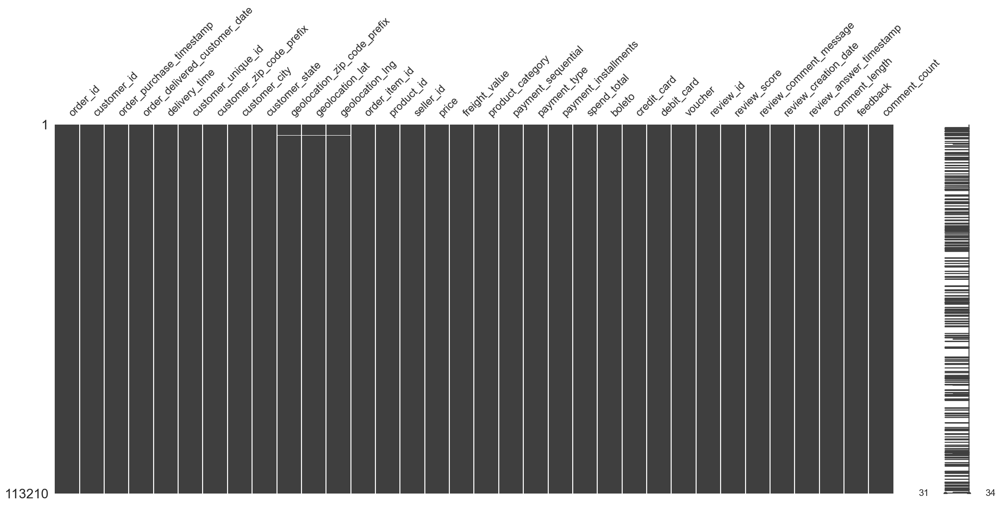

In [103]:
# Visualition du resultat
msn.matrix(data)

Le jeu de données ne contient plus de valeurs manquantes.

<font color = "blue"> **_Traitement d'éventuelles valeurs aberrantes_**

In [104]:
data.describe(include = "number")

,delivery_time,geolocation_lat,geolocation_lng,order_item_id,price,freight_value,payment_sequential,payment_installments,spend_total,boleto,credit_card,debit_card,voucher,review_score,comment_length,comment_count
count,113202,112913.000000,112913.000000,113210.000000,113210.000000,113210.000000,113210.000000,113210.000000,113210.000000,113210.000000,113210.000000,113210.000000,113210.00000,113210.000000,113210.000000,113210.000000
mean,12 days 10:36:09.042914436,-21.246085,-46.205936,1.195036,119.866958,20.002577,1.090805,2.943530,139.869535,0.316430,1.145879,0.019875,0.29962,4.082678,29.057919,1.815635
std,9 days 08:32:12.271096955,5.554190,4.039328,0.687479,181.150493,15.710680,0.686623,2.779129,188.179518,0.927866,1.264189,0.196141,2.49022,1.345782,48.979018,2.851022
min,0 days 12:48:07,-33.689948,-72.668881,1.000000,0.850000,0.000000,1.000000,1.000000,6.080000,0.000000,0.000000,0.000000,0.00000,1.000000,0.000000,1.000000
25%,6 days 17:43:59,-23.591583,-48.109940,1.000000,39.900000,13.080000,1.000000,1.000000,55.270000,0.000000,1.000000,0.000000,0.00000,4.000000,0.000000,1.000000
50%,10 days 04:31:20.500000,-22.928999,-46.632826,1.000000,74.900000,16.320000,1.000000,2.000000,91.790000,0.000000,1.000000,0.000000,0.00000,5.000000,0.000000,1.000000
75%,15 days 12:04:39,-20.199186,-43.658131,1.000000,133.000000,21.190000,1.000000,4.000000,157.300000,0.000000,1.000000,0.000000,0.00000,5.000000,43.000000,2.000000
max,208 days 08:26:32,42.184003,-8.723762,21.000000,6735.000000,409.680000,26.000000,24.000000,6929.310000,20.000000,24.000000,7.000000,75.00000,5.000000,208.000000,75.000000


In [105]:
data.describe(include = "object")

,order_id,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,geolocation_zip_code_prefix,product_id,seller_id,product_category,payment_type,review_id,review_comment_message,review_creation_date,review_answer_timestamp
count,113210,113210,113210,113210,113210,113210,112913,113210,113210,113210,113210,113210,113210,113210,113210
unique,94488,94488,91481,14825,4071,27,14678,31481,2907,71,4,94312,33955,626,94164
top,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,9a736b248f67d166d2fbb006bcb877c3,24220,sao paulo,São Paulo,24220,aca2eb7d00ea1a7b8ebd4e68314663af,4a3ca9315b744ce9f8e9374361493884,bed_bath_table,credit_card,eef5dbca8d37dfce6db7d7b16dd0525e,no comment,2017-12-19 00:00:00,2017-08-17 22:17:55
freq,63,63,75,150,17870,47822,150,526,2093,11685,83536,63,65845,524,63


Il semble ne pas avoir de valeur aberrante dans le jeu de données.

<font color = "blue"> **_Suppression variables_** <br>

Je vais à présent procéder à la suppression des variables non pertinentes.

In [106]:
# Visualisation des colonnes
data.columns

Index(['order_id', 'customer_id', 'order_purchase_timestamp',
       'order_delivered_customer_date', 'delivery_time', 'customer_unique_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng',
       'order_item_id', 'product_id', 'seller_id', 'price', 'freight_value',
       'product_category', 'payment_sequential', 'payment_type',
       'payment_installments', 'spend_total', 'boleto', 'credit_card',
       'debit_card', 'voucher', 'review_id', 'review_score',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'comment_length', 'feedback',
       'comment_count'],
      dtype='object')

**_Choix des colonnes à supprimer_** <br>
- "customer_id" : c'est l'identifiant client pour chaque commande. La colonne "customer_unique_id" permet déjà d'identifier les clients ;
- "seller_id" : le projet est basé sur les clients et ne concernent pas les vendeurs ;
- "customer_zip_code_prefix" : les colonnes "customer_city" et "customer_state" permettent déjà de géolocaliser les clients ;
- review_id

In [107]:
# Suppression des colonnes 
data.drop(columns = ["customer_id", "seller_id", "customer_zip_code_prefix", "review_id"], inplace = True)
data.shape

(113210, 30)

In [108]:
# Visualisation des 3 premières lignes
data.head(3)

,order_id,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_city,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,...,credit_card,debit_card,voucher,review_score,review_comment_message,review_creation_date,review_answer_timestamp,comment_length,feedback,comment_count
0,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,2.0,0.0,2.0,4.0,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4
1,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,2.0,0.0,2.0,4.0,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4
2,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,2.0,0.0,2.0,4.0,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4


<font color = "blue">**IV. Création des variables**<br>

Cette section est consacrée à la création des variables, dans l'objectif de :
- Procéder à la classification RFM des clients et ;
- D’avoir une seule ligne d'informations par client.

<font color = "blue">**_1. Création des variables pour l'analyse RFM_**<br>

<font color = "blue">**_a) Calcul de la Récence :_**  

Période écoulée depuis le dernier achat d'un client.

In [109]:
# Recherche des dernières dates d'achat par client
dernier_achat = data.groupby(["customer_unique_id"]).agg({"order_purchase_timestamp" : "max"}).reset_index()

# Renommer les colonnes
dernier_achat.columns = ["customer_unique_id", "date_recente"]
dernier_achat.head()

,customer_unique_id,date_recente
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42


In [110]:
# Conversion de la colonne date_recente au format date
dernier_achat["date_recente"] = pd.to_datetime(dernier_achat["date_recente"], format='%Y-%m-%d %H:%M:%S')

_Calcul de la récence : pour le faire, je vais calculer la différence en jours entre chaque valeur de la colonne "most_recent" du DataFrame "dernier_achat" et la date la plus récente de cette colonne. Le résultat de ce calcul sera ensuite stocké dans une nouvelle colonne "recence" du DataFrame "dernier_achat"._

In [111]:
dernier_achat["recence"] = (dernier_achat["date_recente"].max() - dernier_achat["date_recente"]).dt.days
dernier_achat.head()

,customer_unique_id,date_recente,recence
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,111
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,114
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,536
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,320
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,287


<font color = "blue"> **_b) Calcul de la fréquence :_** 
    
Le nombre total d'achats effectués par les clients entre 2016 à 2018.

In [112]:
# Regrouper les données par client et compter le nombre d'achat
frequence_achat = data.groupby(["customer_unique_id"]).agg({"order_id" : "count"}).reset_index()

# Renommer les colonnes
frequence_achat.columns = ["customer_unique_id","frequence"]

# Visualiser le resultat
frequence_achat.head()

,customer_unique_id,frequence
0,0000366f3b9a7992bf8c76cfdf3221e2,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1
2,0000f46a3911fa3c0805444483337064,1
3,0000f6ccb0745a6a4b88665a16c9f078,1
4,0004aac84e0df4da2b147fca70cf8255,1


<font color = "blue"> **_c) Calcul du montant :_** 
    
Montant total dépensé par client sur la période donnée. Si la fréquence des achats étaient importante, j'aurais pu opter pour la moyenne des dépenses par client.

In [113]:
# Regrouper les données par client et additionner les montant dépensés représentés par la colonne "spend_total"
moyenne_depense = data.groupby("customer_unique_id").agg({"spend_total" : "sum"}).reset_index()

# Renommer les colonnes
moyenne_depense.columns = ["customer_unique_id", "montant"]

# Visualiser le resultat
moyenne_depense.head()

,customer_unique_id,montant
0,0000366f3b9a7992bf8c76cfdf3221e2,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,27.19
2,0000f46a3911fa3c0805444483337064,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,43.62
4,0004aac84e0df4da2b147fca70cf8255,196.89


**_Regroupement des dataset_**

In [114]:
RFM = dernier_achat.merge(frequence_achat, on = "customer_unique_id")
RFM = RFM.merge(moyenne_depense, on = "customer_unique_id")
RFM.head()

,customer_unique_id,date_recente,recence,frequence,montant
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,111,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,114,1,27.19
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,536,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,320,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,287,1,196.89


In [115]:
# suppression des colonnes non utiles pour la suite
RFM.drop("date_recente", axis = 1, inplace = True)

In [116]:
data = data.merge(RFM, on = "customer_unique_id")
data.head(2)

,order_id,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_city,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,...,review_score,review_comment_message,review_creation_date,review_answer_timestamp,comment_length,feedback,comment_count,recence,frequence,montant
0,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,4.0,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4,331,4,160.24
1,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,4.0,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4,331,4,160.24


In [117]:
data.shape

(113210, 33)

<font color = "blue">**_2. Autres variables_**

<font color = "blue">**_a) Niveau de satisfaction client_**

Pour évaluer la sastifaction de chaque client, je vais calculer pour chaque client le score moyen attribué.

In [118]:
# Score moyen par client
# Regouper les données par clients et calculer la score moyen attribué
note_moyenne = data.groupby("customer_unique_id")["review_score"].mean()

# Créer une nouvelle colonne "score_moyen" et associer la valeur correspondante à la série "note_moyenne"
data["score_moyen"] = data["customer_unique_id"].map(note_moyenne)
data.head(2)

,order_id,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_city,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,...,review_comment_message,review_creation_date,review_answer_timestamp,comment_length,feedback,comment_count,recence,frequence,montant,score_moyen
0,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4,331,4,160.24,4.25
1,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,170.0,True,4,331,4,160.24,4.25


<font color = "blue">**_b) Règlement_**

**_Moyenne du nombre de d'échéance_**

In [119]:
# Regrouper les données par clients et calculer la moyenne des échéances
installment_payment = data.groupby("customer_unique_id")["payment_installments"].mean()

# Créer une nouvelle colonne dans data et associer les valeurs de paiement échelonné moyen
data["installment_payment_mean"] = data["customer_unique_id"].map(installment_payment)

**_Coût moyen du panier_**

In [120]:
# Regrouper les données clients et calculer la somme moyenne dépensée
panier_moyen = data.groupby("customer_unique_id")["spend_total"].mean()

# Créer une nouvelle colonne "average_basket" dans le dataset "data" et associer la valeur correspondante à la série "panier_moyen"
data["average_basket"] = data["customer_unique_id"].map(panier_moyen)

**_Panier le plus cher_**

In [121]:
# Regrouper les données par client et extraire le montant des dépenses le plus élevé
panier_eleve = data.groupby("customer_unique_id")["spend_total"].max()

# Créer une nouvelle colonne "max_basket" dans le dataset "data" et associer la valeur correspondante à la série "panier_eleve"
data["max_basket"] = data["customer_unique_id"].map(panier_eleve)

**_Panier le plus bas_**

In [122]:
# Regrouper les données par client et extraire le montant des dépenses le plus élevé
panier_bas = data.groupby("customer_unique_id")["spend_total"].min()

# Créer une nouvelle colonne "min_basket" dans le dataset "data" et associer la valeur correspondante à la série "panier_eleve"
data["min_basket"] = data["customer_unique_id"].map(panier_bas)

# Visualisation des modifications avec les 5 premières lignes
data.head()

,order_id,order_purchase_timestamp,order_delivered_customer_date,delivery_time,customer_unique_id,customer_city,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,...,feedback,comment_count,recence,frequence,montant,score_moyen,installment_payment_mean,average_basket,max_basket,min_basket
0,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,True,4,331,4,160.24,4.25,1.0,40.06,44.11,38.71
1,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,True,4,331,4,160.24,4.25,1.0,40.06,44.11,38.71
2,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02 10:56:33,2017-10-10 21:25:13,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,True,4,331,4,160.24,4.25,1.0,40.06,44.11,38.71
3,69923a4e07ce446644394df37a710286,2017-09-04 11:26:38,2017-09-05 19:20:20,1 days 07:53:42,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,3149,-23.576983,-46.587161,...,True,4,331,4,160.24,4.25,1.0,40.06,44.11,38.71
4,128e10d95713541c87cd1a2e48201934,2017-08-15 18:29:31,2017-08-18 14:44:43,2 days 20:15:12,3a51803cc0d012c3b5dc8b7528cb05f7,sao paulo,São Paulo,3366,-23.564630,-46.534268,...,True,1,378,1,37.77,4.00,3.0,37.77,37.77,37.77


<font color = "blue">**_c) Les commandes_**

**_Nombre de commande par client_**

In [123]:
# Regrouper les données par client et compter le nombre de commande par client
nombre_commande = data.groupby("customer_unique_id")["order_id"].count()

# Créer une nouvelle colonne "total_order" dans le dataset "data" et associer la valeur correspondante à la série "nombre_commande"
data["total_order"] = data["customer_unique_id"].map(nombre_commande)

<font color = "blue">**_d) Catégorie préférée_**

Je souhaite ici créer une colonne par catégorie de produit pour y dispatcher le nombre de produits achetés sur les commandes passées. Et ensuite calculer le ratio du nombre de produits par catégorie sur le nombre de produits total acheté par le client. Le bémol c'est qu'il y a 73 catégories de produit, il sara donc fastidieux de créer gérer 73 catégories. <br> Pour contourner ce problème, je vais commencer par rassembler les catégories de produit dans des groupes de catégories. Cette solution sera aussi utile pour la modélisation, car réaliser un encodage sur 73 valeurs n'est pas idéal.<br>

Pour créer les groupes de catégorie, je m'inspirer du site internet statista, qui fournit une liste contenant les principales catégories de produits achetés en ligne parmi les internautes :
* Fashion, clothing and accessories
* Health and Beauty
* Toys and baby equipment
* Books, CDs and other physical media
* Groceries, food and drink
* Technology (including phones and computers)
* Home and furniture
* Flowers and gifts
* Other

In [124]:
# Définition des conditions pour chaque catégorie de produits
conditions = [
    data['product_category'].str.contains("fashio|luggage"),
    data['product_category'].str.contains("health|beauty|perfum"),
    data['product_category'].str.contains("toy|baby|diaper"),
    data['product_category'].str.contains("book|cd|dvd|media"),
    data['product_category'].str.contains("grocer|food|drink"),
    data['product_category'].str.contains("phon|compu|tablet|electro|consol"),
    data['product_category'].str.contains("home|furnitur|garden|bath|house|applianc"),
    data['product_category'].str.contains("flow|gift|stuff"),
    data['product_category'].str.contains("sport")
]

# Définition des valeurs correspondantes à chaque condition
choices = [
    'fashion_clothing_accessories',
    'health_beauty',
    'toys_baby',
    'books_cds_media',
    'groceries_food_drink',
    'technology',
    'home_furniture',
    'flowers_gifts',
    'sport'
]

# Assignation de la catégorie de groupe en fonction des conditions
data['category_group'] = np.select(conditions, choices, default='other')

In [125]:
# drop product_category_name column
data.drop("product_category", axis=1, inplace=True)

In [126]:
data["category_group"].unique()

array(['home_furniture', 'toys_baby', 'health_beauty', 'other',
       'groceries_food_drink', 'sport', 'flowers_gifts', 'technology',
       'fashion_clothing_accessories', 'books_cds_media'], dtype=object)

In [127]:
# Visualisation des groupes de catégories les plus representés

# Calcul du nombre de représentation des catégories
categorie = data["category_group"].value_counts().reset_index()
categorie.columns = ["categorie", "Quantite"]

# Tri des données par ordre décroissant
categorie = categorie.sort_values(by="Quantite", ascending=False)

# Extraction des 15 catégories les plus recherchés
categorie = categorie.head(15)

# Extraction des données x et y pour les tracés
x = categorie["categorie"]
y = categorie["Quantite"]


# Use textposition='auto' for direct text
fig = go.Figure(data = [go.Bar(x = x, y = y, text = y, textposition='auto')])

fig.show()

création d'une variable par catégorie produit.

In [128]:
# Regrouper les données par client et catégorie puis calcul du nombre d'article commandé
categories_customers = data.groupby(["customer_unique_id", "category_group"]).agg({"order_item_id": "count"}).unstack() # Pivoter les données

# Suppression du niveau d'index supérieur dans les noms de colonnes
categories_customers.columns = categories_customers.columns.droplevel(0)

# Remplissage des valeurs manquantes avec 0, pour les cas où un client n'a pas effectué d'achat dans une certaine catégorie.
categories_customers.fillna(0, inplace=True)

# Calcul de la somme des articles par client et ajout de cette valeur dans une nouvelle colonne "total_items"
categories_customers["total_items"] = categories_customers.sum(axis=1)

# ratio of total items
for col in categories_customers.columns:
    if (col != "total_items"): # Exclure la colonne "total_items" de la transformation suivante
        
        # Calcul du ratio de chaque catégorie (colonnes autres que "total_items") par rapport au nombre total d'articles
        categories_customers[col] = (categories_customers[col]/categories_customers["total_items"])

# Réinitialisation de l'index
categories_customers.reset_index(inplace=True)

categories_customers.head(3)

category_group,customer_unique_id,books_cds_media,fashion_clothing_accessories,flowers_gifts,groceries_food_drink,health_beauty,home_furniture,other,sport,technology,toys_baby,total_items
0,0000366f3b9a7992bf8c76cfdf3221e2,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0000f46a3911fa3c0805444483337064,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


In [129]:
# Fusion de "categories_customers" et "data"
data = data.merge(categories_customers, on = "customer_unique_id")

<font color = "blue">**IV. Création du dataframe final**

Je vais à présent supprimer les colonnes qui ne seront plus utiles et conserver uniquement les colonnes nécessaires à la segmentation de la clientèle.

In [130]:
# Visualisation des colonnes
data.columns

Index(['order_id', 'order_purchase_timestamp', 'order_delivered_customer_date',
       'delivery_time', 'customer_unique_id', 'customer_city',
       'customer_state', 'geolocation_zip_code_prefix', 'geolocation_lat',
       'geolocation_lng', 'order_item_id', 'product_id', 'price',
       'freight_value', 'payment_sequential', 'payment_type',
       'payment_installments', 'spend_total', 'boleto', 'credit_card',
       'debit_card', 'voucher', 'review_score', 'review_comment_message',
       'review_creation_date', 'review_answer_timestamp', 'comment_length',
       'feedback', 'comment_count', 'recence', 'frequence', 'montant',
       'score_moyen', 'installment_payment_mean', 'average_basket',
       'max_basket', 'min_basket', 'total_order', 'category_group',
       'books_cds_media', 'fashion_clothing_accessories', 'flowers_gifts',
       'groceries_food_drink', 'health_beauty', 'home_furniture', 'other',
       'sport', 'technology', 'toys_baby', 'total_items'],
      dtype='obje

In [131]:
# Création d'une liste contenant les colonnes à supprimer
suppression = ["order_id", 'category_group','review_score', 'order_item_id', "geolocation_zip_code_prefix",
               'product_id', "spend_total", 'review_comment_message', 'payment_sequential','payment_installments', 
               'order_delivered_customer_date', 'payment_type', 'review_creation_date', 'review_answer_timestamp',]

In [132]:
data.drop(suppression, axis = 1, inplace = True)
data.head()

,order_purchase_timestamp,delivery_time,customer_unique_id,customer_city,customer_state,geolocation_lat,geolocation_lng,price,freight_value,boleto,...,fashion_clothing_accessories,flowers_gifts,groceries_food_drink,health_beauty,home_furniture,other,sport,technology,toys_baby,total_items
0,2017-10-02 10:56:33,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,-23.576983,-46.587161,29.99,8.72,0.0,...,0.0,0.0,0.0,0.0,0.75,0.0,0.0,0.0,0.25,4.0
1,2017-10-02 10:56:33,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,-23.576983,-46.587161,29.99,8.72,0.0,...,0.0,0.0,0.0,0.0,0.75,0.0,0.0,0.0,0.25,4.0
2,2017-10-02 10:56:33,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,-23.576983,-46.587161,29.99,8.72,0.0,...,0.0,0.0,0.0,0.0,0.75,0.0,0.0,0.0,0.25,4.0
3,2017-09-04 11:26:38,1 days 07:53:42,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,-23.576983,-46.587161,35.39,8.72,0.0,...,0.0,0.0,0.0,0.0,0.75,0.0,0.0,0.0,0.25,4.0
4,2017-08-15 18:29:31,2 days 20:15:12,3a51803cc0d012c3b5dc8b7528cb05f7,sao paulo,São Paulo,-23.564630,-46.534268,29.99,7.78,0.0,...,0.0,0.0,0.0,0.0,1.00,0.0,0.0,0.0,0.00,1.0


<font color = "blue"> **_Exploration du jeu de données finals_**

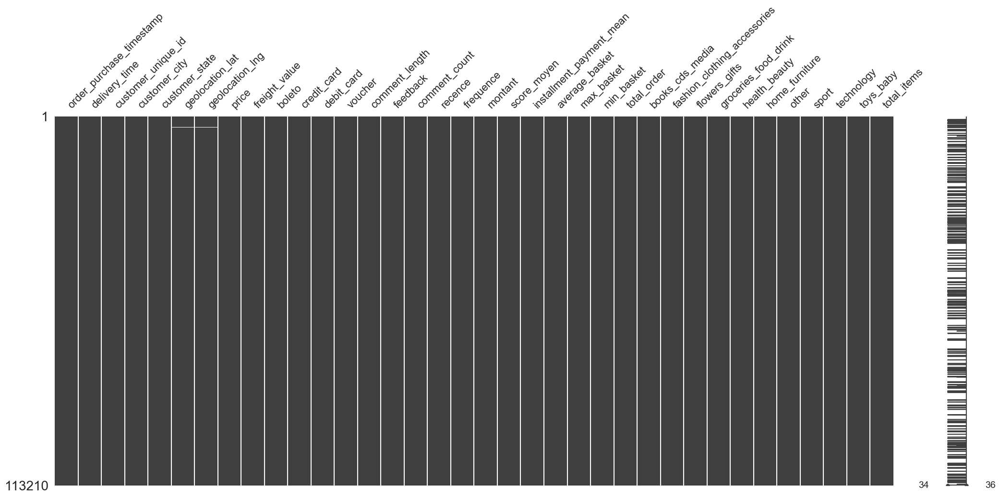

In [133]:
# Recherche des valeurs nulles
msn.matrix(data)
plt.show()

In [134]:
# Calcul pourcentage de valeur nulle
(data.isnull().sum() * 100 / len(data)).sum()

0.5317551453051851

Le taux des valeurs manquantes est faible (0.52 %), je peut supprimer les lignes avec au moins une valeur manquante sans impacter négativement les données.

In [135]:
# Visualisation des lignes nulles
data.dropna(inplace=True)
data.isnull().sum().sum()

0

In [136]:
# Recherche des doublons
data.duplicated().where(data.duplicated() != False).count()

15677

In [137]:
duplicates_mask = data.duplicated(keep = False)  # Obtention du masque booléen des doublons
duplicates = data[duplicates_mask]  # Extraction des lignes correspondantes aux doublons
duplicates.head(50)

,order_purchase_timestamp,delivery_time,customer_unique_id,customer_city,customer_state,geolocation_lat,geolocation_lng,price,freight_value,boleto,...,fashion_clothing_accessories,flowers_gifts,groceries_food_drink,health_beauty,home_furniture,other,sport,technology,toys_baby,total_items
0,2017-10-02 10:56:33,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,-23.576983,-46.587161,29.99,8.72,0.0,...,0.0,0.000000,0.0,0.0,0.75,0.000000,0.0,0.0,0.25,4.0
1,2017-10-02 10:56:33,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,-23.576983,-46.587161,29.99,8.72,0.0,...,0.0,0.000000,0.0,0.0,0.75,0.000000,0.0,0.0,0.25,4.0
2,2017-10-02 10:56:33,8 days 10:28:40,7c396fd4830fd04220f754e42b4e5bff,sao paulo,São Paulo,-23.576983,-46.587161,29.99,8.72,0.0,...,0.0,0.000000,0.0,0.0,0.75,0.000000,0.0,0.0,0.25,4.0
32,2018-08-21 10:00:25,7 days 08:57:57,958ac7760e5484df1496ba5833ab6117,gaspar,Santa Catarina,-26.851927,-49.023383,116.90,22.75,0.0,...,0.0,0.000000,0.0,1.0,0.00,0.000000,0.0,0.0,0.00,2.0
33,2018-08-21 10:00:25,7 days 08:57:57,958ac7760e5484df1496ba5833ab6117,gaspar,Santa Catarina,-26.851927,-49.023383,116.90,22.75,0.0,...,0.0,0.000000,0.0,1.0,0.00,0.000000,0.0,0.0,0.00,2.0
34,2018-01-02 17:56:52,13 days 23:15:45,60a1e88691ef46c62b52fb2b994d7675,paraiba do sul,Rio de Janeiro,-22.164290,-43.292220,117.90,12.83,0.0,...,0.0,0.000000,0.0,1.0,0.00,0.000000,0.0,0.0,0.00,2.0
35,2018-01-02 17:56:52,13 days 23:15:45,60a1e88691ef46c62b52fb2b994d7675,paraiba do sul,Rio de Janeiro,-22.164290,-43.292220,117.90,12.83,0.0,...,0.0,0.000000,0.0,1.0,0.00,0.000000,0.0,0.0,0.00,2.0
42,2018-05-02 10:19:23,6 days 10:46:42,7dd163b8e3d4e09daa9e16091dd6dd26,sao paulo,São Paulo,-23.571450,-46.647981,119.90,15.72,0.0,...,0.0,0.000000,0.0,1.0,0.00,0.000000,0.0,0.0,0.00,2.0
43,2018-05-02 10:19:23,6 days 10:46:42,7dd163b8e3d4e09daa9e16091dd6dd26,sao paulo,São Paulo,-23.571450,-46.647981,119.90,15.72,0.0,...,0.0,0.000000,0.0,1.0,0.00,0.000000,0.0,0.0,0.00,2.0
65,2018-08-18 22:34:35,9 days 19:23:52,f5985137de910a1e58ed6bc3214a4100,florestopolis,Paraná,-22.866573,-51.390543,116.90,22.75,0.0,...,0.0,0.000000,0.0,1.0,0.00,0.000000,0.0,0.0,0.00,2.0


La présence des doublons est dû au fait que certaines commandes ont été enregistrés plusieurs fois au nom du même client. Pour traiter ces doublons, je vais regrouper les données par clients et calculer les moyens des variables numériques et conserver la première occurrence pour les variables catégorielles.

In [138]:
# Calculer la moyenne des variables numériques en regroupant par l'identifiant client
mean_numeric = data.groupby('customer_unique_id').mean(numeric_only = True).reset_index()
mean_numeric.drop("feedback", axis = 1, inplace = True)

# Calculer la moyenne de la colonne date en regroupant par l'identifiant client
mean_date = data.groupby('customer_unique_id')['delivery_time'].mean().reset_index()

# Conserver la première valeur des variables catégorielles en regroupant par l'identifiant client
first_categorical = data.select_dtypes(exclude = "number")
first_categorical = first_categorical.groupby('customer_unique_id').first().reset_index()

# Fusionner les résultats en un seul DataFrame
data = pd.concat([first_categorical, mean_date, mean_numeric], axis=1)

# Afficher les informations du nouveau jeu de données
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91225 entries, 0 to 91224
Data columns (total 38 columns):
 #   Column                        Non-Null Count  Dtype          
---  ------                        --------------  -----          
 0   customer_unique_id            91225 non-null  object         
 1   order_purchase_timestamp      91225 non-null  datetime64[ns] 
 2   customer_city                 91225 non-null  object         
 3   customer_state                91225 non-null  object         
 4   feedback                      91225 non-null  bool           
 5   customer_unique_id            91225 non-null  object         
 6   delivery_time                 91225 non-null  timedelta64[ns]
 7   customer_unique_id            91225 non-null  object         
 8   geolocation_lat               91225 non-null  float64        
 9   geolocation_lng               91225 non-null  float64        
 10  price                         91225 non-null  float64        
 11  freight_value  

In [139]:
data.head(2)

,customer_unique_id,order_purchase_timestamp,customer_city,customer_state,feedback,customer_unique_id,delivery_time,customer_unique_id,geolocation_lat,geolocation_lng,...,fashion_clothing_accessories,flowers_gifts,groceries_food_drink,health_beauty,home_furniture,other,sport,technology,toys_baby,total_items
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,cajamar,São Paulo,True,0000366f3b9a7992bf8c76cfdf3221e2,6 days 09:52:10,0000366f3b9a7992bf8c76cfdf3221e2,-23.340235,-46.830140,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,osasco,São Paulo,True,0000b849f77a49e4a4ce2b2a4ca5be3f,3 days 06:51:15,0000b849f77a49e4a4ce2b2a4ca5be3f,-23.559115,-46.787626,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0


In [140]:
# Viusalisation des statistiques descriptives
data.describe().T

,count,mean,std,min,25%,50%,75%,max
delivery_time,91225,12 days 12:18:46.243789206,9 days 10:49:14.230499201,0 days 12:48:07,6 days 18:30:28,10 days 05:00:35,15 days 15:13:26,208 days 08:26:32
geolocation_lat,91225.0,-21.19205,5.612552,-33.689948,-23.590285,-22.924015,-20.138476,42.184003
geolocation_lng,91225.0,-46.189327,4.057428,-72.668881,-48.124795,-46.632926,-43.62933,-8.723762
price,91225.0,125.684517,188.792442,0.85,42.9,79.0,139.9,6735.0
freight_value,91225.0,20.206478,15.734199,0.0,13.37,16.425,21.22,409.68
boleto,91225.0,0.239715,0.570396,0.0,0.0,0.0,0.0,20.0
credit_card,91225.0,0.909498,0.722995,0.0,1.0,1.0,1.0,24.0
debit_card,91225.0,0.017682,0.153036,0.0,0.0,0.0,0.0,7.0
voucher,91225.0,0.065355,0.556017,0.0,0.0,0.0,0.0,75.0
comment_length,91225.0,27.404518,47.198916,0.0,0.0,0.0,40.0,208.0


**_Exploration des distribution des variables numériques_**

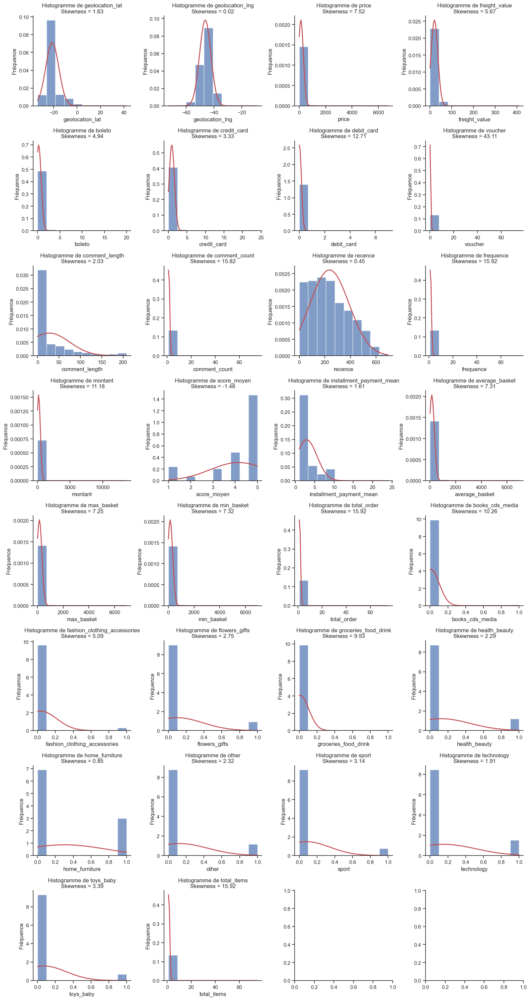

In [141]:
# Sélectionner les variables numériques
numerique = data.select_dtypes(include = ["float64", "int64"])

# Calculer le nombre total d'histogrammes
num_plots = len(numerique)

# Calculer le nombre de lignes et de colonnes pour la grille
num_rows = 8
num_cols = 4

# Créer une grille d'axes avec la fonction subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(16, 30))

# Aplatir la grille d'axes pour itérer dessus
axes = axes.flatten()

# Itérer sur les variables et les axes correspondants
for i, var in enumerate(numerique):
    # Sélectionner l'axe correspondant à la position actuelle
    ax = axes[i]

    # Générer l'histogramme pour la variable sur l'axe sélectionné
    ax.hist(data[var], density = True, alpha = 0.7)

    # Configurer le titre de l'histogramme
    ax.set_title(f'Histogramme de {var}')

    # Configurer les étiquettes des axes
    ax.set_xlabel(var)
    ax.set_ylabel('Fréquence')
    
    # Obtenir les paramètres de la distribution
    mu, sigma = stats.norm.fit(data[var])

    # Générer la courbe de distribution
    x = np.linspace(data[var].min(), data[var].max(), 100)
    y = stats.norm.pdf(x, mu, sigma)
    ax.plot(x, y, 'r-', linewidth=2)
    
    # Calculer le skewness (asymétrie)
    skew = stats.skew(data[var])

    # Configurer le titre de l'histogramme avec le skewness
    ax.set_title(f'Histogramme de {var}\nSkewness = {skew:.2f}')

    # Configurer les étiquettes des axes
    ax.set_xlabel(var)
    ax.set_ylabel('Fréquence')

# Supprimer les axes inutilisés de la grille
if num_plots < num_rows * num_cols:
    for j in range(num_plots, num_rows * num_cols):
        fig.delaxes(axes[j])

# Ajuster automatiquement les espacements entre les sous-graphiques
fig.tight_layout()

# Afficher les histogrammes
plt.show()

_Toutes les distributions sont asymétriques et étendue vers la droite, à l'exeption de la recence et de "home_furniture". Les variables devront donc être standardisées avant de procéder à la modélisation._

**_Exploration des boîtes à moustache_** <br>
L'objectif est d'idendifier la présence éventuelle de valeurs aberrantes et des outliers.

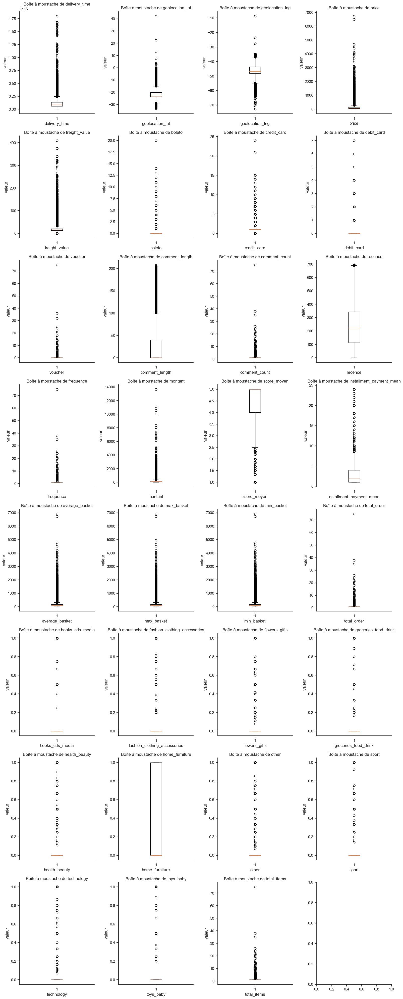

In [142]:
# Sélectionner les variables numériques
numerique = data.select_dtypes(include = "number")

# Calculer le nombre total de boîtes à moustache à tracer
num_plots = len(numerique)

# Calculer le nombre de lignes et de colonnes pour la grille
num_rows = 8
num_cols = 4

# Créer une grille d'axes avec la fonction subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(16, 40))

# Aplatir la grille d'axes pour itérer dessus
axes = axes.flatten()

# Itérer sur les variables et les axes correspondants
for i, var in enumerate(numerique):
    # Sélectionner l'axe correspondant à la position actuelle
    ax = axes[i]

    # Générer la boîte à moustache pour la variable sur l'axe sélectionné
    ax.boxplot(data[var])

    # Configurer le titre de l'histogramme
    ax.set_title(f'Boîte à moustache de {var}')


    # Configurer les étiquettes des axes
    ax.set_xlabel(var)
    ax.set_ylabel('valeur')

# Supprimer les axes inutilisés de la grille
if num_plots < num_rows * num_cols:
    for j in range(num_plots, num_rows * num_cols):
        fig.delaxes(axes[j])

# Ajuster automatiquement les espacements entre les sous-graphiques
fig.tight_layout(pad = 1.2)

# Afficher les boîtes à moustache
plt.show()

_D'après les graphes ci-dessus, plusieurs variables présentent des outliers, mais aucune valeur aberrante n'a été noté. La présence des outliers conditionnera la méthode de standardisation à utiliser lors de la préparation des variables pour la modélisation._

**_Résumé :_**
- Le nombre de jours moyen du dernier achat à partir de la date de référence est de 200 jours ;
- Très peu de client commande régulièrement, le pic des fréquences des commandes est de 1 ;
- Le coût moyen du panier est relativement faible, autour de 203 R$ ;
- L'expérience d'achat des clients est bonne dans l'ensemble, avec une note moyenne de 4/5. Et à quasi tous les achats, un avis est donné ;
- Les achats s'effectuent principalement en journée et en début de soirée. Et moins les week-ends ;
- Le nombre d'article moyen par panier est de un article ;
- La moyenne des échéances de paiement est d'environ 3.

**_Analyse de la corrélation entre les variables_**

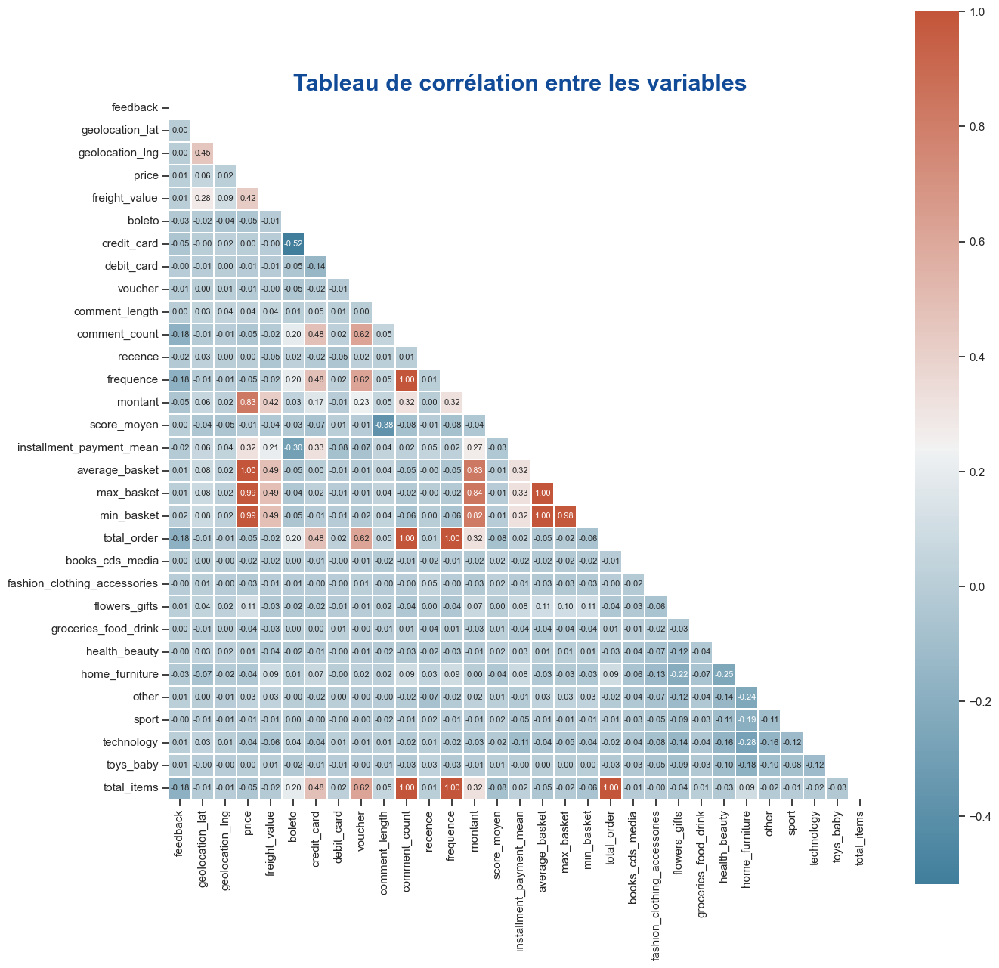

In [143]:
# Réalisation du test de corrélation de Pearson et affichage des résultats dans un heatmap

police_titre = {'family': 'sans serif',
              'color':  '#114b98',
              'weight': 'bold',
              'size': 22,
             }

#Matrice des corrélations
corr = data.corr(numeric_only = True)
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

#heatmap
fig = plt.figure(figsize=(15,15))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, square=True, linewidths=0.01, mask = mask, annot=True, cmap=cmap, fmt='.2f', annot_kws={'size':8})
plt.title("Tableau de corrélation entre les variables", fontdict=police_titre)
plt.show()

Les fortes corrélations observées sont principalement dûes au fait que 97% des clients n'ont acheté qu'une seule fois (fréquence des achats par client = 1). Ces corrélations pourraient donc évoluer à l'avenir, si les clients effectuent plusieurs achats. <br> Par conséquent, je ne vais pas réduire ces corrélations entre les variables et je vais les exploiter en l'état.

### <font color = "blue"> Feature engineering

##### <font color = "blue"> Encodage des variables qualitative

In [144]:
# Visualisation du nombre de modalités des variables qualitatives
data.select_dtypes(exclude = ["number"]).nunique()

customer_unique_id          91225
order_purchase_timestamp    90999
customer_city                4028
customer_state                 27
feedback                        2
customer_unique_id          91225
customer_unique_id          91225
dtype: int64

In [145]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91225 entries, 0 to 91224
Data columns (total 38 columns):
 #   Column                        Non-Null Count  Dtype          
---  ------                        --------------  -----          
 0   customer_unique_id            91225 non-null  object         
 1   order_purchase_timestamp      91225 non-null  datetime64[ns] 
 2   customer_city                 91225 non-null  object         
 3   customer_state                91225 non-null  object         
 4   feedback                      91225 non-null  bool           
 5   customer_unique_id            91225 non-null  object         
 6   delivery_time                 91225 non-null  timedelta64[ns]
 7   customer_unique_id            91225 non-null  object         
 8   geolocation_lat               91225 non-null  float64        
 9   geolocation_lng               91225 non-null  float64        
 10  price                         91225 non-null  float64        
 11  freight_value  

In [146]:
data_encoded = pd.get_dummies(data = data, columns = ["customer_city", "customer_state", "feedback"])
data_encoded.head()

,customer_unique_id,order_purchase_timestamp,customer_unique_id,delivery_time,customer_unique_id,geolocation_lat,geolocation_lng,price,freight_value,boleto,...,customer_state_Rio Grande do Sul,customer_state_Rio de Janeiro,customer_state_Rondônia,customer_state_Roraima,customer_state_Santa Catarina,customer_state_Sergipe,customer_state_São Paulo,customer_state_Tocantins,feedback_False,feedback_True
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,0000366f3b9a7992bf8c76cfdf3221e2,6 days 09:52:10,0000366f3b9a7992bf8c76cfdf3221e2,-23.340235,-46.830140,129.90,12.00,0.0,...,0,0,0,0,0,0,1,0,0,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,0000b849f77a49e4a4ce2b2a4ca5be3f,3 days 06:51:15,0000b849f77a49e4a4ce2b2a4ca5be3f,-23.559115,-46.787626,18.90,8.29,0.0,...,0,0,0,0,0,0,1,0,0,1
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,0000f46a3911fa3c0805444483337064,25 days 17:33:44,0000f46a3911fa3c0805444483337064,-27.542880,-48.633426,69.00,17.22,0.0,...,0,0,0,0,1,0,0,0,0,1
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,0000f6ccb0745a6a4b88665a16c9f078,20 days 00:53:24,0000f6ccb0745a6a4b88665a16c9f078,-1.312214,-48.483159,25.99,17.63,0.0,...,0,0,0,0,0,0,0,0,0,1
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,0004aac84e0df4da2b147fca70cf8255,13 days 03:23:14,0004aac84e0df4da2b147fca70cf8255,-23.505548,-47.469705,180.00,16.89,0.0,...,0,0,0,0,0,0,1,0,0,1


In [147]:
data_encoded.info(memory_usage = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91225 entries, 0 to 91224
Columns: 4092 entries, customer_unique_id to feedback_True
dtypes: datetime64[ns](1), float64(30), object(3), timedelta64[ns](1), uint8(4057)
memory usage: 377.3+ MB


_L'utilisation du dummy encoding a généré 1634 colonnes et augmenté significativement la mémoire d'usage, cela pourrait consommer beaucoup de ressource lors de la modélisation. Ce phénomène est dû au fait que le jeu de données contient 4028 villes, ce qui génère trop de variables après encodage. <br> Pour contourner ce problème, je vais regrouper les villes en fonction de leur effectif : les villes avec moins de 100 clients seront catégorisés comme autre et les villes avec plus de 100 clients conserveront leurs noms. <br> Mais Avant, afin de minimiser la perte d'informations, je vais créer une nouvelle variable "distance_haversine" : cette variable représentera la distance qui sépare Olist à la ville de résidence du client._

In [148]:
# Récupération des coordonnées de Olist
olist_lat = -25.43045
olist_lon = -49.29207

In [149]:
import math

def distance_haversine(lat1, lon1, lat2, lon2):
    # Rayon moyen de la Terre en kilomètres
    r = 6371.0

    # Conversion des degrés en radians
    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)

    # Différences de latitude et de longitude
    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad

    # Formule haversine
    a = math.sin(dlat / 2) ** 2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon / 2) ** 2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    distance = r * c

    return distance

In [150]:
# Calcul de la distance haversine entre le centre de l'état du client et Olist 
data['harvesine_distance'] = [distance_haversine(olist_lat, olist_lon, x, y) 
                              for x, y in zip(data.geolocation_lat, 
                                              data.geolocation_lng)]

In [151]:
# Grouper les données par "customer_city" et compter les occurrences de chaque ville
nombre_occurrences = data.groupby('customer_city')['customer_state'].count()

# Trier les valeurs par ordre décroissant et sélectionner les 200 premières villes
top_200_villes = nombre_occurrences.sort_values(ascending=False).head(200).index.tolist()

# Identifier les index des lignes avec des villes qui ne sont pas dans les 200 premières
villes_a_remplacer = data[~data['customer_city'].isin(top_200_villes)].index

# Remplacer les valeurs de la colonne "customer_city" pour les lignes identifiées par 'Autre'
data.loc[villes_a_remplacer, 'customer_city'] = 'Autre'

In [152]:
data.head()

,customer_unique_id,order_purchase_timestamp,customer_city,customer_state,feedback,customer_unique_id,delivery_time,customer_unique_id,geolocation_lat,geolocation_lng,...,flowers_gifts,groceries_food_drink,health_beauty,home_furniture,other,sport,technology,toys_baby,total_items,harvesine_distance
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,cajamar,São Paulo,True,0000366f3b9a7992bf8c76cfdf3221e2,6 days 09:52:10,0000366f3b9a7992bf8c76cfdf3221e2,-23.340235,-46.830140,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,340.842400
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,osasco,São Paulo,True,0000b849f77a49e4a4ce2b2a4ca5be3f,3 days 06:51:15,0000b849f77a49e4a4ce2b2a4ca5be3f,-23.559115,-46.787626,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,327.884342
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,sao jose,Santa Catarina,True,0000f46a3911fa3c0805444483337064,25 days 17:33:44,0000f46a3911fa3c0805444483337064,-27.542880,-48.633426,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,243.864786
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,belem,Pará,True,0000f6ccb0745a6a4b88665a16c9f078,20 days 00:53:24,0000f6ccb0745a6a4b88665a16c9f078,-1.312214,-48.483159,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2683.228049
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,sorocaba,São Paulo,True,0004aac84e0df4da2b147fca70cf8255,13 days 03:23:14,0004aac84e0df4da2b147fca70cf8255,-23.505548,-47.469705,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,282.533262


In [153]:
# Visualisation du nombre de modalités des variables qualitatives
data.select_dtypes(exclude = ["number"]).nunique()

customer_unique_id          91225
order_purchase_timestamp    90999
customer_city                 201
customer_state                 27
feedback                        2
customer_unique_id          91225
customer_unique_id          91225
dtype: int64

_Je procède de nouveau à l'encodage et je vérifie l'impact du regroupement des villes._

In [154]:
data = pd.get_dummies(data = data, columns = ["customer_state", "customer_city"])

**_Traitement de la variable "feedback"_**

In [155]:
# Remplacer les valeurs de la colonne "feedback" : True par 1 et False par 0
data['feedback'] = data['feedback'].astype(int)

In [156]:
data["feedback"].unique()

array([1, 0])

**_Traitement de la variable "delivery_time"_** <br> Cette variable est au format timedelta64[ns], je vais la convertir en jours pour faciliter la standardisation lors de la modélisation.

In [157]:
data["délai_livraison"] = data["delivery_time"] / pd.Timedelta(days=1)
data["délai_livraison"].head()

0     6.411227
1     3.285590
2    25.731759
3    20.037083
4    13.141134
Name: délai_livraison, dtype: float64

In [158]:
# Suppresion de la colonne initial "delivery_time"
data.drop("delivery_time", axis = 1, inplace = True)

In [159]:
data.info(memory_usage = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91225 entries, 0 to 91224
Columns: 265 entries, customer_unique_id to délai_livraison
dtypes: datetime64[ns](1), float64(32), int32(1), object(3), uint8(228)
memory usage: 45.2+ MB


In [160]:
# Création du dataframe 1 ligne par client
data.set_index("customer_unique_id", inplace=True)
data.head()

,order_purchase_timestamp,feedback,geolocation_lat,geolocation_lng,price,freight_value,boleto,credit_card,debit_card,voucher,...,customer_city_varzea paulista,customer_city_viamao,customer_city_vicosa,customer_city_vila velha,customer_city_vinhedo,customer_city_vitoria,customer_city_vitoria da conquista,customer_city_volta redonda,customer_city_votorantim,délai_livraison
customer_unique_id,,,,,,,,,,,,,,,,,,,,,
"(0000366f3b9a7992bf8c76cfdf3221e2, 0000366f3b9a7992bf8c76cfdf3221e2, 0000366f3b9a7992bf8c76cfdf3221e2)",2018-05-10 10:56:27,1,-23.340235,-46.830140,129.90,12.00,0.0,1.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,6.411227
"(0000b849f77a49e4a4ce2b2a4ca5be3f, 0000b849f77a49e4a4ce2b2a4ca5be3f, 0000b849f77a49e4a4ce2b2a4ca5be3f)",2018-05-07 11:11:27,1,-23.559115,-46.787626,18.90,8.29,0.0,1.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,3.285590
"(0000f46a3911fa3c0805444483337064, 0000f46a3911fa3c0805444483337064, 0000f46a3911fa3c0805444483337064)",2017-03-10 21:05:03,1,-27.542880,-48.633426,69.00,17.22,0.0,1.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,25.731759
"(0000f6ccb0745a6a4b88665a16c9f078, 0000f6ccb0745a6a4b88665a16c9f078, 0000f6ccb0745a6a4b88665a16c9f078)",2017-10-12 20:29:41,1,-1.312214,-48.483159,25.99,17.63,0.0,1.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,20.037083
"(0004aac84e0df4da2b147fca70cf8255, 0004aac84e0df4da2b147fca70cf8255, 0004aac84e0df4da2b147fca70cf8255)",2017-11-14 19:45:42,1,-23.505548,-47.469705,180.00,16.89,0.0,1.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,13.141134


In [161]:
# Sauvegarde du jeu de données pour la segmentation
data.to_csv("data1.csv", index = True)